image.png


<h1><center><font size=10><a name='link6'>Data Science and Business Analytics</a></center></font></h1>


<h1><center> Practice Project I </center></h1>

<h1><center>Visualizations for Effective Story Telling</center></h1>



<h1><center> By </center></h1>



<h1><center>Hayford Osumanu </center></h1>



<h1><center>February  2023 </center></h1>


image.png

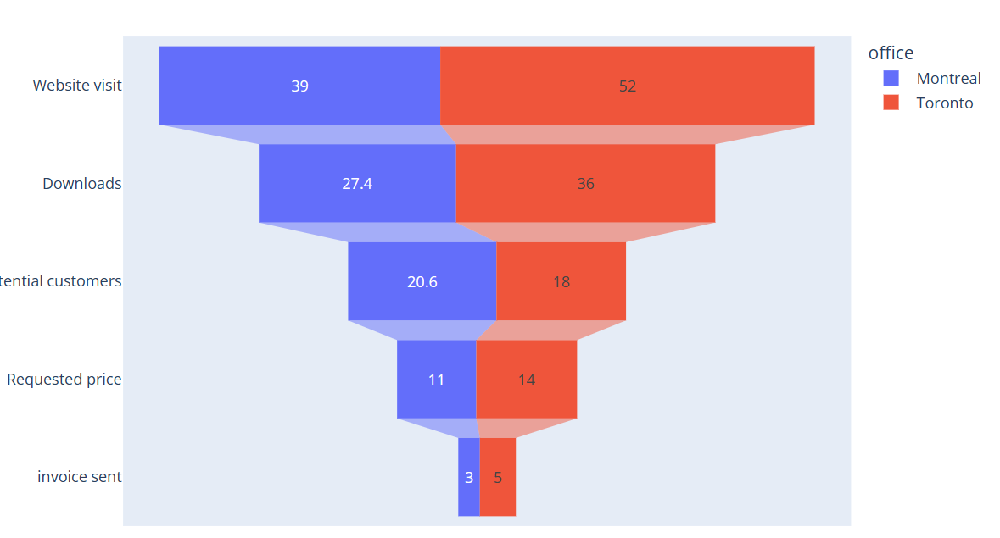

# <h1><left><font size=10><a name='link6'>Content</a></center></font></h1>

### 1.0 Intalling Python Libraries

### 2.0 Importing Python Libraries

### 3.0 Setting Up Codes for Visualization

### 4.0 Python Libraries Overview

### 5.0 Distribution Plots

- ### 5.1 Pyramid Plots

- ### 5.2 Funnel Plots

- #### 5.3 Histogram

- #### 5.4 Box Plots

- #### 5.5 Density Plots

- #### 5.6 Displots

- #### 5.7 Voilin Plots

- #### 5.8 Area Plots

### 6.0 Correlation Plots

- #### 6.1 Correlation Matrix

- #### 6.2 Heatmaps 

- #### 6.3 Pairplots

- #### 6.4 Combined Plots

### 7.0 Circular and Rectangular Plots

- #### 7.1 Sunburst Charts

- #### 7.2 Pie Charts

- #### 7.3 Radar Charts

### 8.0 Time Series and Lines Plots

### 9.0 Folium/Map Plots

image.png

# <h1><left><font size=10><a name='link6'>1.0: Installing Libraries</a></center></font></h1>

In [ ]:
# installing the needed upgrade optimum performance
!pip install squarify
!pip3 install folium==0.5.0
# installing the needed upgrade optimum performance
!pip install nb_black
!pip install ipython --upgrade
!pip install xgboost
!pip install plotly==5.13.0
!pip install dash

In [ ]:
!pip install dash
!pip install jupyter-dash
!pip install pandas

image.png

# <h1><left><font size=10><a name='link6'>2.0: Importing Relevant Libraries</a></center></font></h1>

In [ ]:
# matploblib and seaborn for visualizations
import numpy as np   
import pandas as pd
import folium

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
#import Dash

# matploblib and seaborn for visualizations
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
sns.set_context('talk')

import pandas as pd
import numpy as np

# Removes the limit for the number of displayed columns
pd.set_option("display.max_columns", None)
# Sets the limit for the number of displayed rows
pd.set_option("display.max_rows", 200)

# this will help in making the Python code more structured automatically (good coding practice)
#%load_ext nb_black
import warnings

warnings.filterwarnings("ignore")


In [ ]:
# Other important packages for data data analysis
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
from statsmodels.formula.api import ols
from statsmodels.graphics.gofplots import ProbPlot
import statsmodels.api as sm
from scipy import stats;

image.png

# <h1><left><font size=10><a name='link6'>3.0: Setting Up Codes for Visualizations</a></center></font></h1>

In [ ]:
# function to plot a boxplot and a histogram along the same scale.


def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to the show density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="violet"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins, palette="winter"
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="black", linestyle="-"
    )  # Add median to the histogram

In [ ]:
### function to plot distributions wrt target


def distribution_plot_wrt_target(data, predictor, target):

    fig, axs = plt.subplots(2, 2, figsize=(25, 9))

    target_uniq = data[target].unique()

    axs[0, 0].set_title("Distribution of target for target=" + str(target_uniq[0]))
    sns.histplot(
        data=data[data[target] == target_uniq[0]],
        x=predictor,
        kde=True,
        ax=axs[0, 0],
        color="teal",
        stat="density",
    )

    axs[0, 1].set_title("Distribution of target for target=" + str(target_uniq[1]))
    sns.histplot(
        data=data[data[target] == target_uniq[1]],
        x=predictor,
        kde=True,
        ax=axs[0, 1],
        color="orange",
        stat="density",
    )

    axs[1, 0].set_title("Boxplot w.r.t target")
    sns.boxplot(data=data, x=target, y=predictor, ax=axs[1, 0], palette="gist_rainbow")

    axs[1, 1].set_title("Boxplot (without outliers) w.r.t target")
    sns.boxplot(
        data=data,
        x=target,
        y=predictor,
        ax=axs[1, 1],
        showfliers=False,
        palette="gist_rainbow",
    )

    plt.tight_layout()
    plt.show()

In [ ]:
def stacked_barplot(data, predictor, target):
    """
    Print the category counts and plot a stacked bar chart

    data: dataframe
    predictor: independent variable
    target: target variable
    """
    count = data[predictor].nunique()
    sorter = data[target].value_counts().index[-1]
    tab1 = pd.crosstab(data[predictor], data[target], margins=True).sort_values(
        by=sorter, ascending=False
    )
    print(tab1)
    print("-" * 120)
    tab = pd.crosstab(data[predictor], data[target], normalize="index").sort_values(
        by=sorter, ascending=False
    )
    tab.plot(kind="bar", stacked=True, figsize=(count + 3, 3))
    plt.legend(
        loc="lower left", frameon=False,
    )
    plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
    plt.show()

image.png

# <h1><left><font size=10><a name='link6'>4.0:Python Libraries Overview</a></center></font></h1>

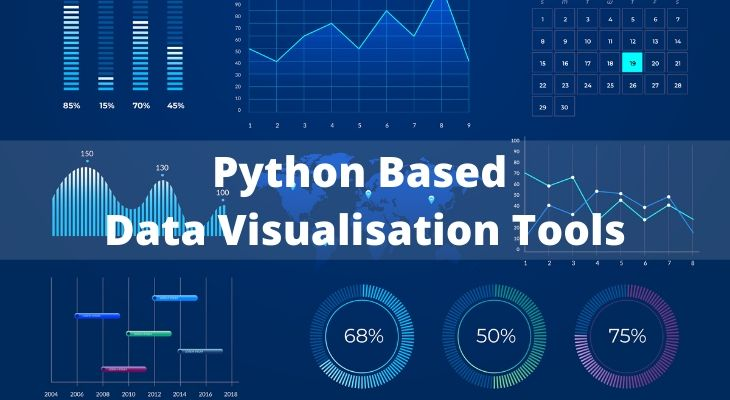

### Python Libraries

A `Python library` is a collection of functions and methods that allow you to perform lots of actions without writing any code. The libraries usually contain built in modules providing different functionalities which you can use directly. 


## `Scientific Computing Libraries`
- `Pandas:` Pandas library is a very high-level Python library that provides high performance easy to use data structures. It has many functions for data importing, manipulation and analysis. In particular, it offers data structures and operations for manipulating numerical tables and timeseries. 


- `Numpy:` NumPy works with N-dimensional arrays in Python. It enables you to do computation efficiently and effectively. It is better than regular Python because of its amazing capabilities.  For example, for working with arrays, dictionaries, functions, datatypes and working with images you need to know NumPy. 


- `Scpy:` SciPy is a collection of numerical algorithms and domain specific toolboxes, including signal processing, optimization, statistics and much more. 
SciPy is a good library for scientific and high performance computation

## `Visualizations Libraries`

- `Matplotlib:`Matplotlib is a very popular plotting package that provides 2D plotting, as well as 3D plotting. Basic knowledge about these three packages which are built on top of Python, is a good asset for data scientists who want to work with real-world problems. 


- `Seaborn:` Another high level visualization library is Seaborn. 
It is based on Matplotlib. It's very easy to generate various plots such as heat maps, time series and violin plots.

- `Folium:` Folium is a powerful data visualization library in Python that was built primarily to help people visualize geospatial data. With Folium, you can create a map of any location in the world as long as you know its latitude and longitude values. You can also create a map and superimpose markers as well as clusters of markers on top of the map for cool and very interesting visualizations. You can also create maps of different styles such as street level map, stamen map etc.
 

## `Algorithmic Libraries`

- `Scikit Learn:` Scikit-learn library contains tools statistical modeling, 
including regression, classification, clustering, and so on.This library is built on NumPy, SciPy and Matplotib. 


- `Statsmodel:` Statsmodels is also a Python module that allows users to explore data, estimate statistical models and perform statistical tests.



image.png

# <h1><left><font size=10><a name='link6'>5.0:Distribution Plots</a></center></font></h1>

## Pyramid Plots

### Pyramid plots are a type of chart used to compare the distribution of a variable between two groups, often male and female populations. They are called "pyramid" plots because the chart has the shape of a pyramid, with the bars gradually decreasing in size as they move up or down the chart.

### In a pyramid plot, the two groups are represented by side-by-side bars, with one group on the left and the other on the right. The bars are divided into segments or bins that represent different ranges or categories of the variable being analyzed. The height of each segment corresponds to the proportion or percentage of the group that falls within that range or category.

### Pyramid plots are commonly used in demographic analysis, such as to compare the age distribution or income distribution of two populations. They can also be used in other fields, such as in marketing to compare the buying habits of different customer groups.

### Pyramid plots are useful because they allow for quick and easy visual comparison of two populations or groups. They can also reveal differences in the distribution of the variable being analyzed, such as differences in the age structure of two populations.

### Advantages

### Advantages of pyramid plots include:

### `Easy to interpret`: Pyramid plots are simple to read and interpret, even for people who are not familiar with statistical analysis.

### `Visual comparison`: Pyramid plots allow for a quick and easy visual comparison of two populations, making it easier to identify differences or similarities.

### `Useful for demographic analysis`: Pyramid plots are commonly used in demographic analysis, such as to compare the age distribution or income distribution of two populations.

### `Shows percentage distribution`: Pyramid plots show the percentage distribution of a variable, making it easy to see the proportion of each group in each catego

### Disadvantages

### However, there are also some disadvantages to using pyramid plots:

### `Limited to two groups`: Pyramid plots can only be used to compare two groups, so they may not be suitable for situations where more than two groups need to be compared.

### `May not be suitable for continuous variables`: Pyramid plots work best for discrete variables, such as age ranges or income brackets. They may not be as effective for continuous variables, such as height or weight, where the distribution may be more complex.

### `May be affected by sample size`: Pyramid plots can be affected by the sample size of each group, so it's important to ensure that the sample sizes are reasonably balanced.

### `Limited flexibility`: Pyramid plots have a fixed structure, so they may not be suitable for displaying complex or multi-dimensional data.

### `Note`

### Overall, pyramid plots are a useful and effective tool for comparing the distribution of a variable between two groups, especially in demographic analysis. However, it's important to consider the limitations and potential biases of the plot when using it for data analysis.

image.png

### Applications of Pyramid Plots

##### `Population Pyramid Showing Users of a Product at Various Stages`

In [ ]:
# Importing Email Campaign Funnel Dataset
import pandas as pd
url="https://raw.githubusercontent.com/hayfordosmandata/DataBank/main/email_campaign_funnel.csv"
df=pd.read_csv(url, encoding="unicode_escape")

# First 4 rows of the deatset
df.head(4)

,Stage,Gender,Users
0,Stage 01: Browsers,Male,-1.492762e+07
1,Stage 02: Unbounced Users,Male,-1.286266e+07
2,Stage 03: Email Signups,Male,-1.136190e+07
3,Stage 04: Email Confirmed,Male,-9.411708e+06


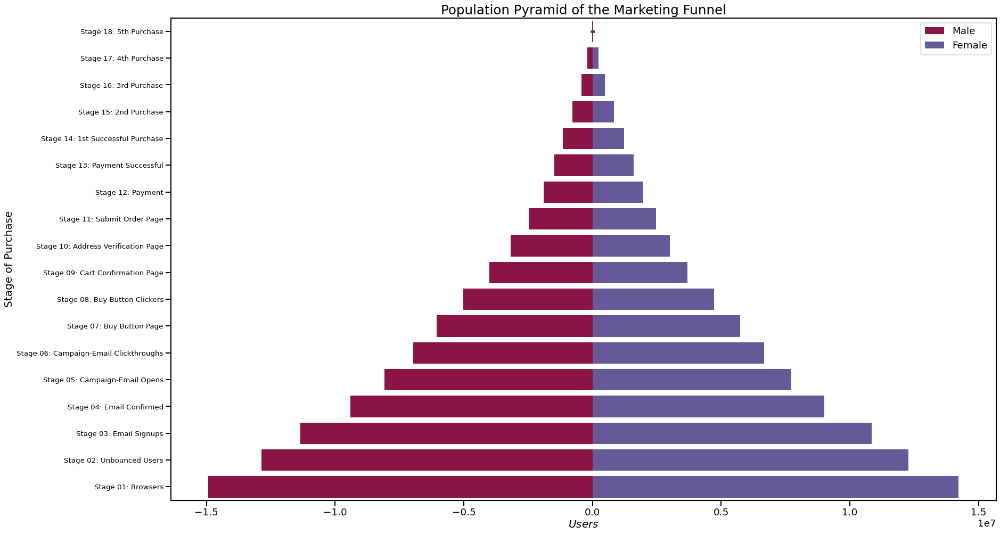

In [ ]:
# Distribution of Population of Pyramid of Marketing Funnel Dataset
plt.figure(figsize=(25,15), dpi= 80)
group_col = 'Gender'
order_of_bars = df.Stage.unique()[::-1]
colors = [plt.cm.Spectral(i/float(len(df[group_col].unique())-1)) for i in range(len(df[group_col].unique()))]

for c, group in zip(colors, df[group_col].unique()):
    sns.barplot(x='Users', y='Stage', data=df.loc[df[group_col]==group, :], order=order_of_bars, color=c, label=group)

# Decorations    
plt.xlabel("$Users$")
plt.ylabel("Stage of Purchase")
plt.yticks(fontsize=12)
plt.title("Population Pyramid of the Marketing Funnel", fontsize=22)
plt.legend()
plt.show()


image.png

## Funnel Plots

###  A funnel chart is a type of chart that is used to visualize a process that starts with a large number of potential customers or prospects and gradually narrows down to a smaller number of customers who make a purchase or take a desired action. It is often used in sales and marketing to track the progression of leads through a sales or marketing funnel.

### The chart is called a "funnel" because it has a wide top and a narrow bottom, like a funnel. Each section of the funnel represents a stage in the process, with the widest section at the top representing the initial stage and the narrowest section at the bottom representing the final stage.

### The height of each section of the funnel corresponds to the number of prospects or leads at that stage, while the width of the funnel corresponds to the percentage of leads that progress to the next stage. The final section of the funnel represents the number of customers who ultimately make a purchase or take the desired action.

### Funnel charts are useful because they can help identify potential bottlenecks or areas of improvement in the sales or marketing process. By tracking the number of leads at each stage of the funnel, businesses can see where prospects drop off and take steps to improve conversion rates and increase the number of customers who make a purchase or take the desired action.

### Funnel charts are commonly used in e-commerce, digital marketing, and sales analytics to help visualize and track customer behavior and sales performance. They can be created using various software tools, including spreadsheet applications, business intelligence software, and specialized data visualization tools.

### Advantages

### Advantages of using funnel charts include:

### `Provides a clear visual representation`: Funnel charts provide a clear and easy-to-understand visual representation of the progress of leads or prospects through a sales or marketing funnel.

### `Helps identify areas for improvement`: Funnel charts can help identify areas of the funnel where prospects drop off or fail to convert, which can help businesses identify areas for improvement and optimize their sales or marketing processes.

### `Shows the effectiveness of marketing campaigns`: Funnel charts can help show the effectiveness of marketing campaigns by tracking the number of leads at each stage of the funnel and identifying which campaigns are driving the most conversions.

### `Can be customized`: Funnel charts can be customized to show the specific stages of a particular sales or marketing process, allowing businesses to focus on the most relevant data.

### Disadvantages

### However, there are also some disadvantages to using funnel charts:

### `May oversimplify complex data`: Funnel charts are designed to simplify complex data and may not be suitable for displaying detailed information or complex relationships.

### Limited to linear processes`: Funnel charts are designed to show linear processes and may not be suitable for displaying more complex or non-linear sales or marketing funnels.

### Requires accurate data`: Funnel charts require accurate and up-to-date data in order to be effective, which may be difficult to obtain in some cases.

### `May not work for all businesses`: Funnel charts are most useful for businesses with a defined sales or marketing process that can be broken down into distinct stages. Businesses that do not have a clear process may find funnel charts less useful.

### `Note`

### Overall, funnel charts are a useful tool for visualizing the progression of leads or prospects through a sales or marketing funnel. However, it's important to consider the limitations and potential biases of the chart whe

### Applications of Funel Plots

##### Customers Activities on Webpage`

In [ ]:
d = dict(
    number=[33, 28, 21, 11, 2],
    stage=["Website visit", "Downloads", "Potential customers", "Requested price", "Invoice sent"])
data=pd.DataFrame(d)
data.head()

,number,stage
0,33,Website visit
1,28,Downloads
2,21,Potential customers
3,11,Requested price
4,2,Invoice sent


In [ ]:
import plotly.express as px
fig = px.funnel(data, x='number', y='stage')
fig.show()

In [ ]:
import plotly.express as px
import pandas as pd
stages = ["Website visit", "Downloads", "Potential customers", "Requested price", "invoice sent"]
df_mtl = pd.DataFrame(dict(number=[39, 27.4, 20.6, 11, 3], stage=stages))
df_mtl['office'] = 'Montreal'
df_toronto = pd.DataFrame(dict(number=[52, 36, 18, 14, 5], stage=stages))
df_toronto['office'] = 'Toronto'
df = pd.concat([df_mtl, df_toronto], axis=0)


In [ ]:
df_mtl.head()

,number,stage,office
0,39.0,Website visit,Montreal
1,27.4,Downloads,Montreal
2,20.6,Potential customers,Montreal
3,11.0,Requested price,Montreal
4,3.0,invoice sent,Montreal


In [ ]:
df_toronto.head()

,number,stage,office
0,52,Website visit,Toronto
1,36,Downloads,Toronto
2,18,Potential customers,Toronto
3,14,Requested price,Toronto
4,5,invoice sent,Toronto


In [ ]:
import plotly.express as px
import pandas as pd
stages = ["Website visit", "Downloads", "Potential customers", "Requested price", "invoice sent"]
df_mtl = pd.DataFrame(dict(number=[39, 27.4, 20.6, 11, 3], stage=stages))
df_mtl['office'] = 'Montreal'
df_toronto = pd.DataFrame(dict(number=[52, 36, 18, 14, 5], stage=stages))
df_toronto['office'] = 'Toronto'
df = pd.concat([df_mtl, df_toronto], axis=0)
fig = px.funnel(df, x='number', y='stage', color='office')
fig.show()

In [ ]:
from plotly import graph_objects as go

fig = go.Figure(go.Funnel(
    y = ["Website visit", "Downloads", "Potential customers", "Requested price", "Finalized"],
    x = [39, 27.4, 20.6, 11, 2],
    textposition = "inside",
    textinfo = "value+percent initial",
    opacity = 0.65, marker = {"color": ["deepskyblue", "lightsalmon", "tan", "teal", "silver"],
    "line": {"width": [4, 2, 2, 3, 1, 1], "color": ["wheat", "wheat", "blue", "wheat", "wheat"]}},
    connector = {"line": {"color": "royalblue", "dash": "dot", "width": 3}})
    )

fig.show()

In [ ]:
from plotly import graph_objects as go

fig = go.Figure()

fig.add_trace(go.Funnel(
    name = 'Montreal',
    y = ["Website visit", "Downloads", "Potential customers", "Requested price"],
    x = [120, 60, 30, 20],
    textinfo = "value+percent initial"))

fig.add_trace(go.Funnel(
    name = 'Toronto',
    orientation = "h",
    y = ["Website visit", "Downloads", "Potential customers", "Requested price", "invoice sent"],
    x = [100, 60, 40, 30, 20],
    textposition = "inside",
    textinfo = "value+percent previous"))

fig.add_trace(go.Funnel(
    name = 'Vancouver',
    orientation = "h",
    y = ["Website visit", "Downloads", "Potential customers", "Requested price", "invoice sent", "Finalized"],
    x = [90, 70, 50, 30, 10, 5],
    textposition = "outside",
    textinfo = "value+percent total"))

fig.show()

In [ ]:
import plotly.express as px
fig = px.funnel_area(names=["The 1st","The 2nd", "The 3rd", "The 4th", "The 5th"],
                    values=[5, 4, 3, 2, 1])
fig.show()

In [ ]:
from plotly import graph_objects as go

fig = go.Figure(go.Funnelarea(
    text = ["The 1st","The 2nd", "The 3rd", "The 4th", "The 5th"],
    values = [5, 4, 3, 2, 1]
    ))
fig.show()

In [ ]:
from plotly import graph_objects as go

fig = go.Figure(go.Funnelarea(
      values = [5, 4, 3, 2, 1], text = ["The 1st","The 2nd", "The 3rd", "The 4th", "The 5th"],
      marker = {"colors": ["deepskyblue", "lightsalmon", "tan", "teal", "silver"],
                "line": {"color": ["wheat", "wheat", "blue", "wheat", "wheat"], "width": [0, 1, 5, 0, 4]}},
      textfont = {"family": "Old Standard TT, serif", "size": 13, "color": "black"}, opacity = 0.65))
fig.show()

In [ ]:
from plotly import graph_objects as go

fig = go.Figure()

fig.add_trace(go.Funnelarea(
    scalegroup = "first", values = [500, 450, 340, 230, 220, 110], textinfo = "value",
    title = {"position": "top center", "text": "Sales for Sale Person A in U.S."},
    domain = {"x": [0, 0.5], "y": [0, 0.5]}))

fig.add_trace(go.Funnelarea(
    scalegroup = "first", values = [600, 500, 400, 300, 200, 100], textinfo = "value",
    title = {"position": "top center", "text": "Sales of Sale Person B in Canada"},
    domain = {"x": [0, 0.5], "y": [0.55, 1]}))

fig.add_trace(go.Funnelarea(
    scalegroup = "second", values = [510, 480, 440, 330, 220, 100], textinfo = "value",
    title = {"position": "top left", "text": "Sales of Sale Person A in Canada"},
    domain = {"x": [0.55, 1], "y": [0, 0.5]}))

fig.add_trace(go.Funnelarea(
            scalegroup = "second", values = [360, 250, 240, 130, 120, 60],
            textinfo = "value", title = {"position": "top left", "text": "Sales of Sale Person B in U.S."},
            domain = {"x": [0.55, 1], "y": [0.55, 1]}))

fig.update_layout(
            margin = {"l": 200, "r": 200}, shapes = [
            {"x0": 0, "x1": 0.5, "y0": 0, "y1": 0.5},
            {"x0": 0, "x1": 0.5, "y0": 0.55, "y1": 1},
            {"x0": 0.55, "x1": 1, "y0": 0, "y1": 0.5},
            {"x0": 0.55, "x1": 1, "y0": 0.55, "y1": 1}])

fig.show()

image.png

## Box Plots

### A box plot, also known as a box-and-whisker plot, is a graphical representation of a numerical data set through their quartiles. The plot displays the distribution of the data, including its range, median, quartiles, and outliers. It is particularly useful when comparing multiple data sets and when analyzing the spread and skewness of the data.

### A box plot consists of five main elements:

### `Median`: A horizontal line within the box, representing the middle value of the data set.

### `Quartiles`: The box is divided into three parts, with the bottom edge representing the first quartile (Q1) and the top edge representing the third quartile (Q3).

### `Interquartile Range (IQR)`: The range of the data between the first and third quartiles, represented by the height of the box.

### `Whiskers`: Lines extending from the box to represent the range of the data, with a length of 1.5 times the IQR. Data points beyond the whiskers are considered outliers and are represented by individual points.

### `Outliers`: Individual points that are beyond the whiskers of the plot, indicating values that are significantly different from the rest of the data set.

### Box plots are often used in statistics, finance, and other fields to compare data sets and identify patterns and outliers in the data. They can be useful in identifying differences and similarities between groups and for understanding the variability of the data.

### When do we use Box Plots

### Box plots are commonly used to visualize the distribution of a numerical dataset, particularly when we want to compare the distributions of multiple datasets or examine the spread and skewness of a single dataset.

### Here are some specific situations where box plots can be useful:

### `Comparing multiple datasets`: Box plots are useful for comparing the distributions of two or more datasets, particularly when the datasets have different means, variances, or skewness.

### `Detecting outliers`: Box plots can highlight potential outliers in a dataset, which are values that are unusually high or low compared to the rest of the dataset.

### `Summarizing central tendency and spread`: Box plots can provide a quick summary of the median, quartiles, and interquartile range of a dataset, which gives an idea of the central tendency and spread of the data.

### `Examining the shape of a distribution`: Box plots can provide insight into the shape of a distribution, particularly if the data is symmetric or skewed.

### Box plots are commonly used in fields such as statistics, data analysis, and data visualization. They are particularly useful in exploratory data analysis and when working with large datasets.

### Advantages 

### Box plots have several advantages when used to represent data.

### `Easy to interpret`: Box plots are simple and easy to understand. They provide a quick and visual summary of the distribution of the data, including the median, quartiles, and potential outliers.

### `Effective in displaying multiple datasets`: Box plots are useful for comparing multiple datasets side by side, making it easy to compare the spread and central tendency of each dataset.

### `Can reveal the presence of outliers`: Box plots can highlight potential outliers in a dataset, which can be useful in identifying data points that are significantly different from the rest of the data.

### `Robust to extreme values`: Box plots are less sensitive to extreme values than other methods of data representation, such as histogra

### Disadvantages


### `Loss of detail`: Box plots do not provide as much detail about the data as other methods of data representation, such as histograms. For example, they do not show the exact shape of the distribution or the frequency of each value.

### `Can be misleading if not used properly`: Box plots can be misleading if the data is not properly scaled or if the whiskers are not correctly calculated.

### `Not suitable for small datasets`: Box plots may not be useful for very small datasets, where there is not enough data to calculate meaningful quartiles.

### `Different types of box plots can be confusing`: There are different types of box plots, such as notched box plots, which can be confusing if not properly understood.

### `Note`

### Overall, box plots are a useful tool for exploring and visualizing numerical data, but they should be used in conjunction with other methods of data representation and with careful consideration of the advantages and disadvantages of their use.

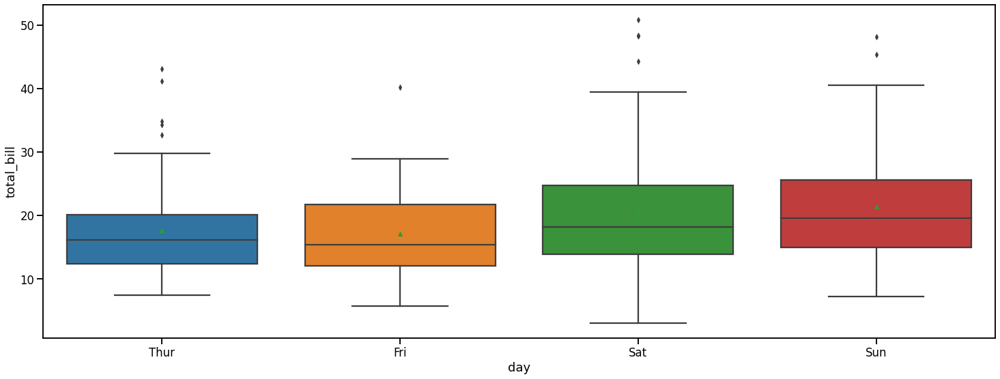

In [ ]:
# The following line of code will help you import the dataset −
df = sns.load_dataset("tips")
# Distribution of Day of the Week and Total Bills
plt.figure(figsize=(25, 9))
sns.boxplot(data=df, x="day", y="total_bill",showmeans="green");

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.box(df, x="day", y="total_bill", color="smoker", notched=True)
fig.show()

image.png

## Violin Plots

### A violin plot is a type of data visualization that combines aspects of a box plot and a kernel density plot to show the distribution of a dataset. It is particularly useful for visualizing the shape and density of the data.

### In a violin plot, the width of the "violin" at a particular point represents the density of the data at that point, while the height of the violin represents the range of values for the data. The median is represented by a horizontal line within the violin, and the box-and-whisker plot of the data can also be overlaid on top of the violin.

### Like box plots, violin plots can be used to compare the distributions of multiple datasets or to examine the spread and skewness of a single dataset. They are particularly useful when the data is not normally distributed or when there are multiple modes in the distribution.

### Advantages

### Advantages of using violin plots include:

### `Provides more information about the data`: Violin plots provide more information about the shape and density of the data than box plots.

### `Shows the presence of multiple modes`: Violin plots can show the presence of multiple modes in the distribution, which may not be apparent in a box plot.

### `Easy to compare distributions`: Violin plots make it easy to compare the distributions of multiple datasets.

### Disadvantages


### Disadvantages of using violin plots include:

### `Can be more difficult to interpret than box plots`: Violin plots can be more difficult to interpret than box plots, particularly if the data has multiple modes.

### `May not be appropriate for small datasets`: Violin plots may not be appropriate for small datasets where the density estimate may not be accurate.

### `Can be computationally expensive`: The computation of the density estimates can be computationally expensive for very large datasets.

### `Note`

### Overall, violin plots are a useful tool for visualizing the distribution of a dataset, particularly when the data is not normally distributed or has multiple modes. However, they should be used in conjunction with other methods of data visualization and with careful consideration of the advantages and disadvantages of their use.


###  Applications of Violin Plots

In [ ]:
# importing the dataset
import pandas as pd
url="https://raw.githubusercontent.com/hayfordosmandata/DataBank/main/Diabetes_1.csv"
df=pd.read_csv(url, encoding="unicode_escape")

# First 4 rows of the dataset
df.head(4)

,Pregnancies,Glucose,Blood Pressure,Skin Thickness,Insulin,BMI,Diabetes Pedigree Function,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0


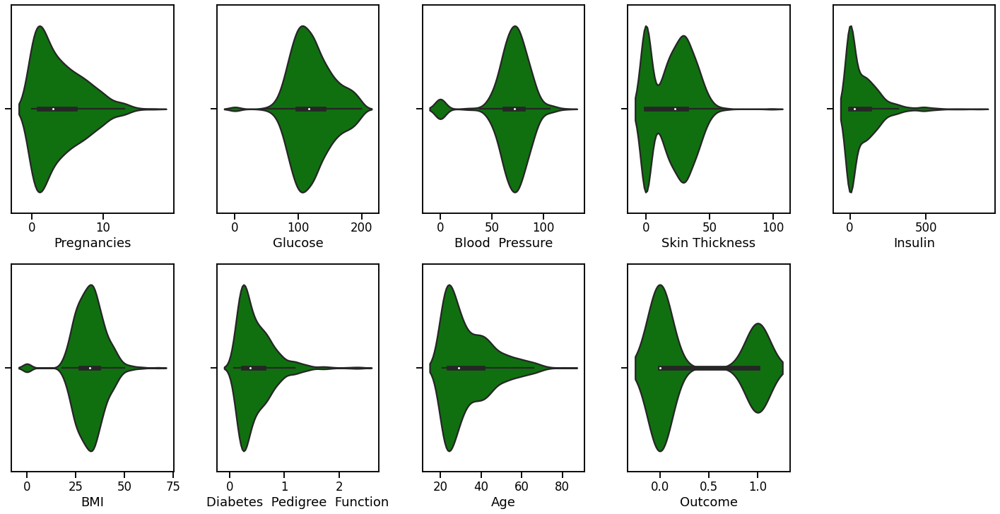

In [ ]:
# Checking the voilin plot of the numerical variables
cols = 5
rows = 5
num_cols = df.select_dtypes(exclude='category').columns
fig = plt.figure(figsize= (20,25))
for i, col in enumerate(num_cols):
    
    ax=fig.add_subplot( rows, cols, i+1)
    
    sns.violinplot( x=df[col], ax=ax,color="green")
    
fig.tight_layout()  
plt.show()

image.png

## Histogram

### A histogram is a type of graph or chart that represents the distribution of a set of numerical data. It is commonly used to show the frequency distribution of a variable, which can be continuous or discrete.

### A histogram consists of a series of vertical bars or rectangles, each representing a specific range or interval of the data being analyzed. The height of each bar represents the frequency of data points falling within that interval. The bars are typically adjacent to each other, and the width of each bar is determined by the size of the interval it represents.

### Histograms are often used in statistics to understand the shape and spread of a data set, and to identify any patterns or anomalies. They are also useful for identifying outliers or extreme values, as well as for comparing multiple data sets.

### When do we use Histogram

### Histograms are a useful tool for analyzing and visualizing the distribution of numerical data. They are particularly helpful when you want to:

### `Identify the shape of a distribution`: A histogram can help you identify whether the distribution of your data is symmetrical, skewed, or has multiple peaks.

### `Understand the central tendency and spread of data`: A histogram can help you identify the mean, median, and mode of your data, as well as its range and variability.

### `Identify outliers`: Histograms can help you identify any values that fall outside of the expected range or appear as extreme values in your data set.

### `Compare multiple data sets`: You can use histograms to compare the distributions of different data sets, for example, to see if they have similar or different shapes.

### `Make data-driven decisions`: Histograms can help you make informed decisions based on the distribution of your data, such as determining whether a process is in control or identifying areas for improvement.

### Histograms are widely used in many fields, including finance, healthcare, engineering, and social sciences, to name a few.

### Advantages

### Advantages of using histograms include:

### `Easy to interpret`: Histograms are easy to understand, and their graphical representation makes it easy to identify the distribution and patterns in the data.

### `Shows the shape of the distribution`: Histograms can reveal the shape of the distribution, such as whether it is symmetric or skewed, and whether it has one or multiple peaks.

### `Provides information about central tendency and dispersion`: Histograms can give information about the mean, median, mode, range, and standard deviation of the data.

### `Helps to identify outliers`: Histograms can identify values that are significantly different from the rest of the data, which can be important in identifying potential errors or anomalies.

### `Enables easy comparison`: Histograms can be used to compare multiple data sets easily.

### Disadvantages

### Disadvantages of using histograms include:

### `Subjective`: The appearance of a histogram can be subjective, depending on how the data is grouped, the number of bins used, and the scales chosen.

### `Sensitivity to bin size`: The shape of the histogram can change depending on the size of the bins used.

### `Limited to one variable`: Histograms only represent one variable at a time, and cannot provide information on the relationship between different variables.

### `Can be misinterpreted`: If the axes of the histogram are not labeled correctly or are misleading, the histogram can be misinterpreted.

### `Note`

### Overall, histograms are a useful tool for summarizing and understanding the distribution of data, but it's important to keep in mind their limitations and potential sources of bias.

### Histogram

In [ ]:
# To Run the graphs, remove the # and run the path first.
#path="https://raw.githubusercontent.com/hayfordosmandata/DataBank/main/Wind_Train.csv"

In [ ]:
data1=pd.read_csv(path)
data1.head(4)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-4.464606,-4.679129,3.101546,0.506130,-0.221083,-2.032511,-2.910870,0.050714,-1.522351,3.761892,-5.714719,0.735893,0.981251,1.417884,-3.375815,-3.047303,0.306194,2.914097,2.269979,4.394876,-2.388299,0.646388,-1.190508,3.132986,0.665277,-2.510846,-0.036744,0.726218,-3.982187,-1.072638,1.667098,3.059700,-1.690440,2.846296,2.235198,6.667486,0.443809,-2.369169,2.950578,-3.480324,0
1,3.365912,3.653381,0.909671,-1.367528,0.332016,2.358938,0.732600,-4.332135,0.565695,-0.101080,1.914465,-0.951458,-1.255259,-2.706522,0.193223,-4.769379,-2.205319,0.907716,0.756894,-5.833678,-3.065122,1.596647,-1.757311,1.766444,-0.267098,3.625036,1.500346,-0.585712,0.783034,-0.201217,0.024883,-1.795474,3.032780,-2.467514,1.894599,-2.297780,-1.731048,5.908837,-0.386345,0.616242,0
2,-3.831843,-5.824444,0.634031,-2.418815,-1.773827,1.016824,-2.098941,-3.173204,-2.081860,5.392621,-0.770673,1.106718,1.144261,0.943301,-3.163804,-4.247825,-4.038909,3.688534,3.311196,1.059002,-2.143026,1.650120,-1.660592,1.679910,-0.450782,-4.550695,3.738779,1.134404,-2.033531,0.840839,-1.600395,-0.257101,0.803550,4.086219,2.292138,5.360850,0.351993,2.940021,3.839160,-4.309402,0
3,1.618098,1.888342,7.046143,-1.147285,0.083080,-1.529780,0.207309,-2.493629,0.344926,2.118578,-3.053023,0.459719,2.704527,-0.636086,-0.453717,-3.174046,-3.404347,-1.281536,1.582104,-1.951778,-3.516555,-1.206011,-5.627854,-1.817653,2.124142,5.294642,4.748137,-2.308536,-3.962977,-6.028730,4.948770,-3.584425,-2.577474,1.363769,0.622714,5.550100,-1.526796,0.138853,3.101430,-1.277378,0


In [ ]:
data1.shape

(20000, 41)

<IPython.core.display.Javascript object>

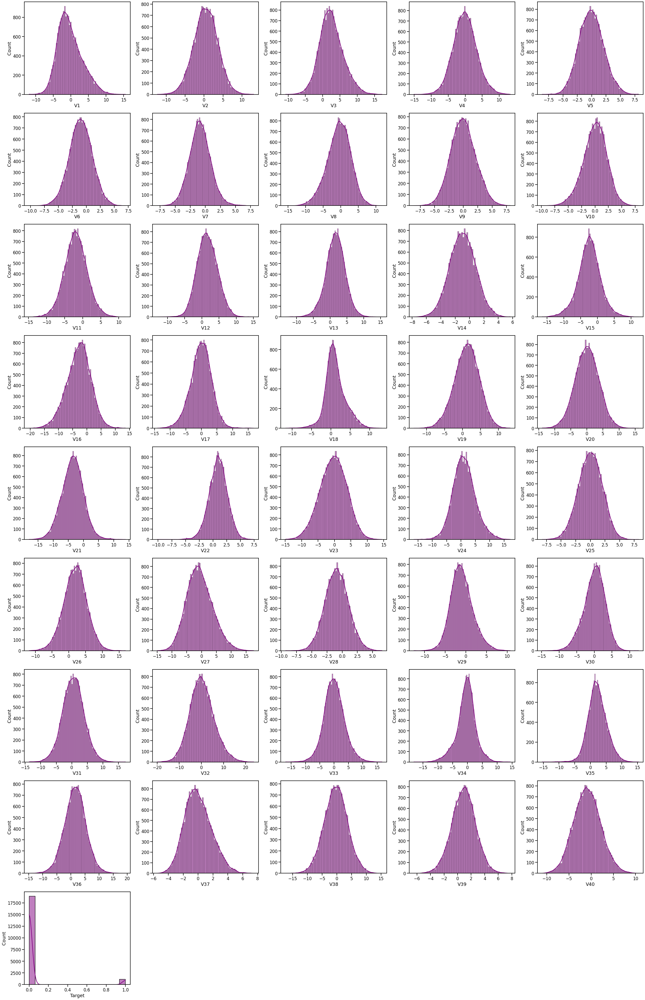

In [ ]:
# Checking the histogram plot of numerical variables of the entire dataset
cols = 5
rows = 9
num_cols = data1.select_dtypes(exclude='category').columns
fig = plt.figure( figsize=(cols*7, rows*6))
for i, col in enumerate(num_cols):
    
    ax=fig.add_subplot(rows,cols,i+1)
    
    sns.histplot(x =data1[col], kde = True, ax = ax,color="purple")
    
fig.tight_layout()  
plt.show()

### Histogram and Box Plot Combine

In [ ]:
# importing the dataset
import pandas as pd
url="https://raw.githubusercontent.com/hayfordosmandata/DataBank/main/Diabetes_1.csv"
hb=pd.read_csv(url, encoding="unicode_escape")

# First 4 rows of the dataset
hb.head(4)

,Pregnancies,Glucose,Blood Pressure,Skin Thickness,Insulin,BMI,Diabetes Pedigree Function,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0


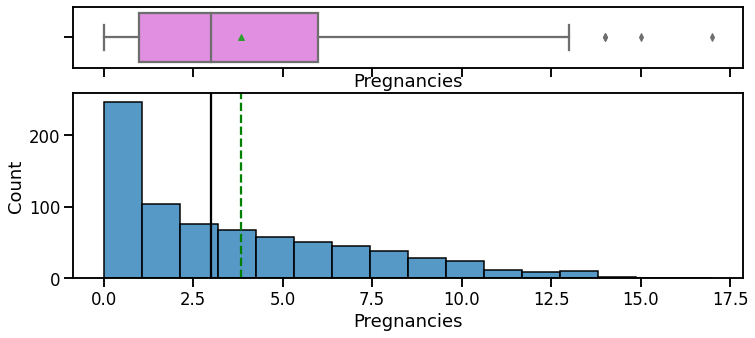

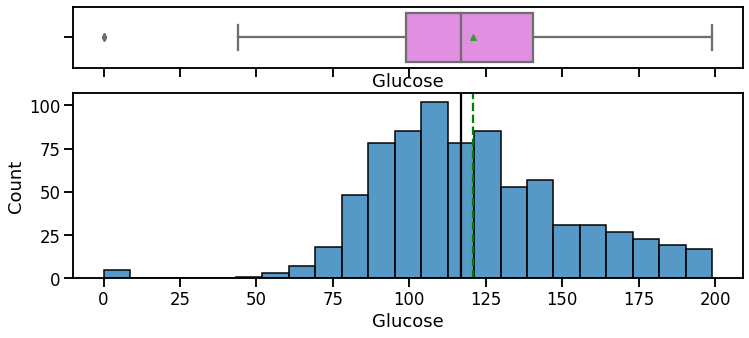

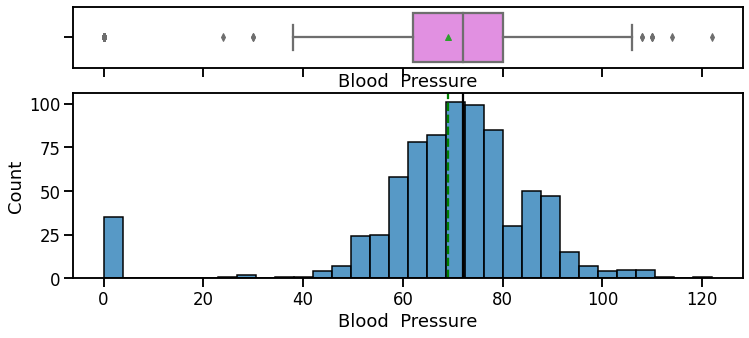

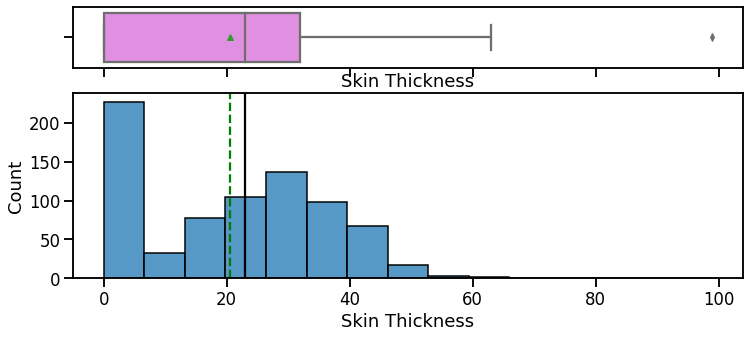

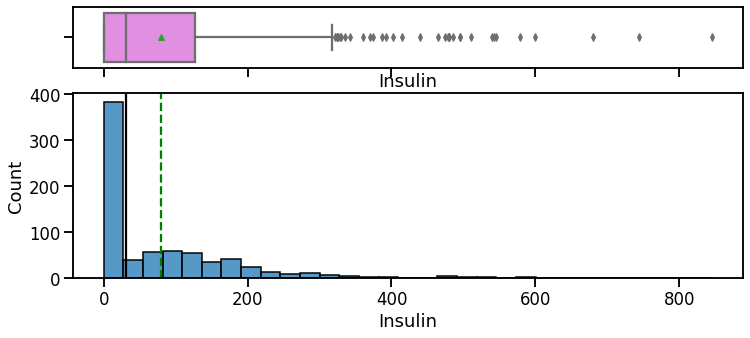

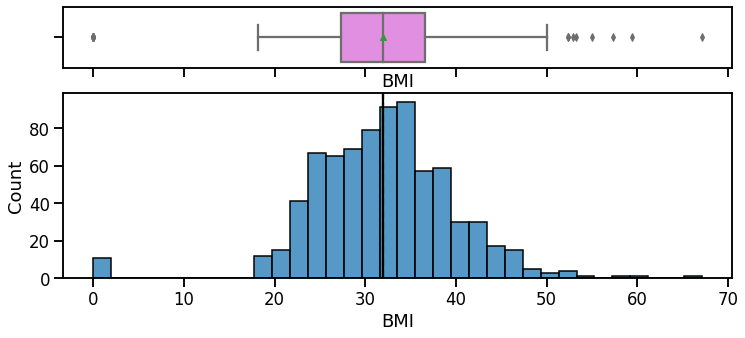

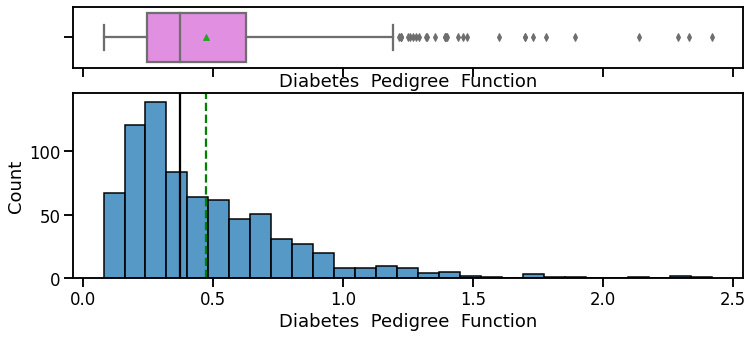

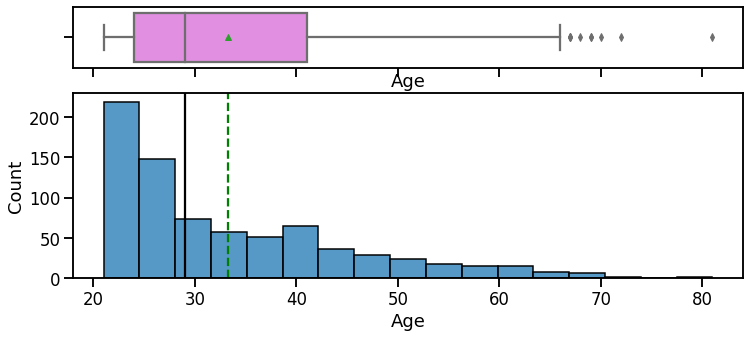

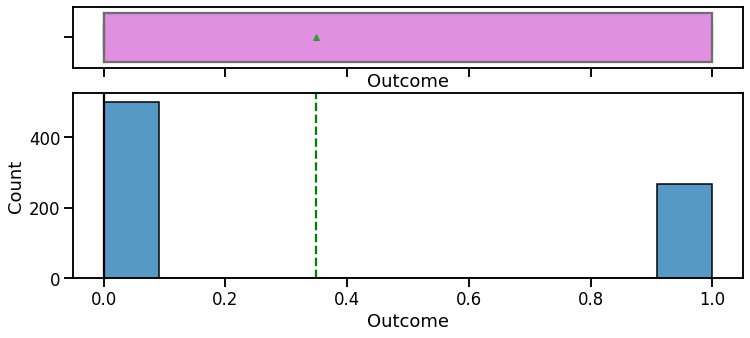

In [ ]:
for feature in hb.columns:
    histogram_boxplot(
        hb, feature, figsize=(12, 5), kde=False, bins=None)

In [ ]:
for feature in data1.columns:
    histogram_boxplot(
        data1, feature, figsize=(12, 7), kde=False, bins=None
    )  ## Please change the dataframe name as you define while reading the data

image.png

## Displots

### A displot is a type of data visualization in seaborn, a Python data visualization library, that is used to plot the distribution of a single variable or the relationship between two variables. It is a flexible and powerful tool for visualizing data and can be used in a variety of contexts.

### The displot function in seaborn can create several types of plots, including:

### Histograms: A histogram is a graph that shows the frequency of values in a dataset. In a displot, a histogram can be created by specifying the "hist" parameter.

### `Kernel density estimation (KDE) plots`: A KDE plot is a non-parametric way to estimate the probability density function of a variable. In a displot, a KDE plot can be created by specifying the "kde" parameter.

### `Rug plots`: A rug plot is a plot of data points as tick marks along the x or y-axis. In a displot, a rug plot can be created by specifying the "rug" parameter.

### `Cumulative distribution function (CDF) plots`: A CDF plot is a graph that shows the cumulative probability of a variable. In a displot, a CDF plot can be created by specifying the "cumulative" parameter.

### Displots are useful when exploring a single variable or the relationship between two variables in a dataset. They can be used to identify the shape of the distribution, the presence of outliers, and the range of the data.

### Displots can also be used to compare the distributions of different variables in a dataset, by creating a subplot for each variable and displaying them side by side.

### `Note`

### In summary, displots are a powerful tool for visualizing data in a variety of contexts, and can be used to explore the distribution of a single variable or the relationship between two variables. They are particularly useful in exploratory data analysis and when working with large datasets.

### Advantages

### Here are some advantages and disadvantages of using displots:

### `Easy to use`: Displots in seaborn are relatively easy to create and customize, making them accessible to users with varying levels of experience.

### `Flexible`: Displots can be used to display a variety of distributional information about a single variable or the relationship between two variables, including histograms, KDE plots, rug plots, and CDF plots.

### `Useful for exploratory data analysis`: Displots are useful for exploratory data analysis because they allow users to quickly identify the shape of a distribution, detect outliers, and understand the range of the data.

### `Can be used to compare distributions`: Displots can be used to compare the distributions of multiple variables in a dataset, which can help identify patterns or differences in the data.

### Disadvantages

### Limited information about the distribution`: While displots are useful for providing a quick overview of the distribution of a variable, they do not provide as much information as other types of visualization, such as box plots or violin plots.

### `Can be misleading`: Displots can be misleading if the data is not normally distributed or if there are outliers. It is important to choose the appropriate type of plot and parameters to accurately represent the data.

### `Can be computationally expensive`: Displots can be computationally expensive for large datasets, particularly when using KDE plots, which can take a long time to compute.

### `May require additional statistical analysis`: Displots are a useful tool for exploratory data analysis, but they may not provide enough information for more advanced statistical analysis. Additional statistical tests or modeling may be required to draw definitive conclusions about the data.

### `Note`

### Overall, displots are a useful tool for visualizing data and exploring the distribution of a variable or the relationship between two variables. However, it is important to be aware of their limitations and to use them in conjunction with other types of visualization and statistical analysis to draw accurate conclusions about the data.

### Applications of Displots

In [ ]:
import plotly.express as px
df = px.data.tips()
df.head(4)

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2


In [ ]:
# Making a list of all catrgorical variables
cat_col = list(df.select_dtypes("object").columns)

# Printing number of count of each unique value in each column
for column in cat_col:
    print(df[column].value_counts())
    # print("cat_col")

Male      157
Female     87
Name: sex, dtype: int64
No     151
Yes     93
Name: smoker, dtype: int64
Sat     87
Sun     76
Thur    62
Fri     19
Name: day, dtype: int64
Dinner    176
Lunch      68
Name: time, dtype: int64


#### `Distribution of Total Bill and Day of the Week`

In [ ]:
# Extrating the distribution of Sex, Day of the week, Smoker and Total Bill
df.groupby(['day','sex'])['total_bill'].count().sort_values(ascending = False).head()

day   sex   
Sat   Male      59
Sun   Male      58
Thur  Female    32
      Male      30
Sat   Female    28
Name: total_bill, dtype: int64

In [ ]:
# comparing Total Bill in Relation to day
df.groupby(["day"])["total_bill"].describe()

,count,mean,std,min,25%,50%,75%,max
day,,,,,,,,
Fri,19.0,17.151579,8.302660,5.75,12.0950,15.38,21.7500,40.17
Sat,87.0,20.441379,9.480419,3.07,13.9050,18.24,24.7400,50.81
Sun,76.0,21.410000,8.832122,7.25,14.9875,19.63,25.5975,48.17
Thur,62.0,17.682742,7.886170,7.51,12.4425,16.20,20.1550,43.11


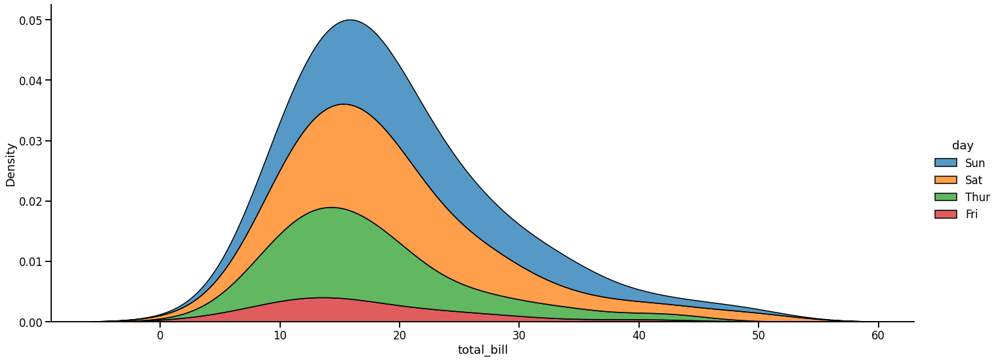

In [ ]:
# Distribution of Total bills based on the day of the week
sns.displot(
    data=df,
    x="total_bill",
    hue="day",
    multiple="stack",
    kind="kde",
    height=8,
    aspect=2.5,);

In [ ]:
# comparing Total Bill vs Time
df.groupby(["time"])["total_bill"].describe()

,count,mean,std,min,25%,50%,75%,max
time,,,,,,,,
Dinner,176.0,20.797159,9.142029,3.07,14.4375,18.390,25.2825,50.81
Lunch,68.0,17.168676,7.713882,7.51,12.2350,15.965,19.5325,43.11


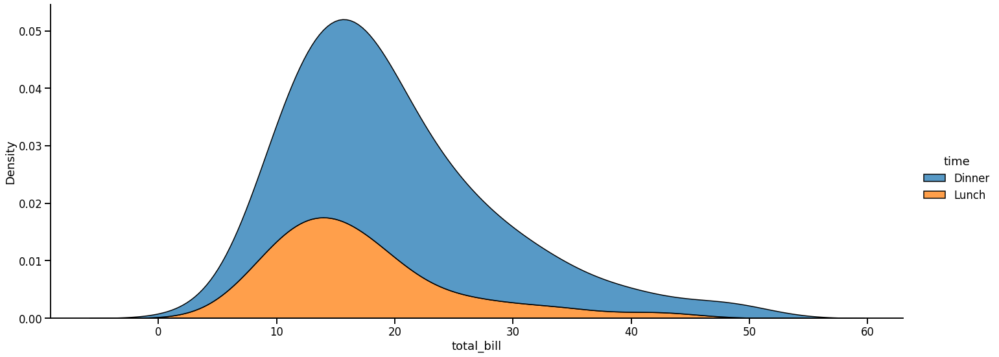

In [ ]:
# Distribution of Total bills based vs Time
sns.displot(
    data=df,
    x="total_bill",
    hue="time",
    multiple="stack",
    kind="kde",
    height=8,
    aspect=2.5,);

image.png

##  `More examples of Histogram, Violin and Boxplot`

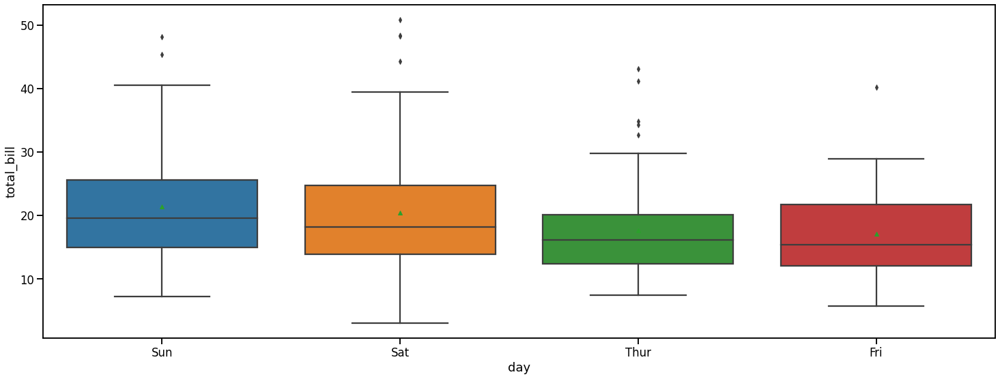

In [ ]:
import plotly.express as px
df = px.data.tips()

# Distribution of Day of the Week and Total Bills
plt.figure(figsize=(25, 9))
sns.boxplot(data=df, x="day", y="total_bill",showmeans="green");

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.box(df, x="day", y="total_bill", color="smoker", notched=True)
fig.show()

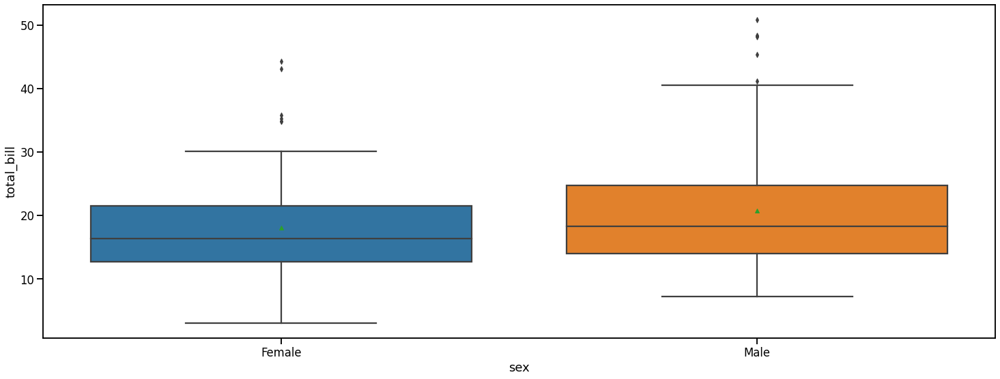

In [ ]:
import plotly.express as px
df = px.data.tips()

# Distribution of Sex and Total Bills
plt.figure(figsize=(25, 9))
sns.boxplot(data=df, x="sex", y="total_bill",showmeans="green");

image.png

### Histogram Boxplot

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.histogram(df, x="total_bill", y="tip", color="sex", marginal="rug", hover_data=df.columns)
fig.show()

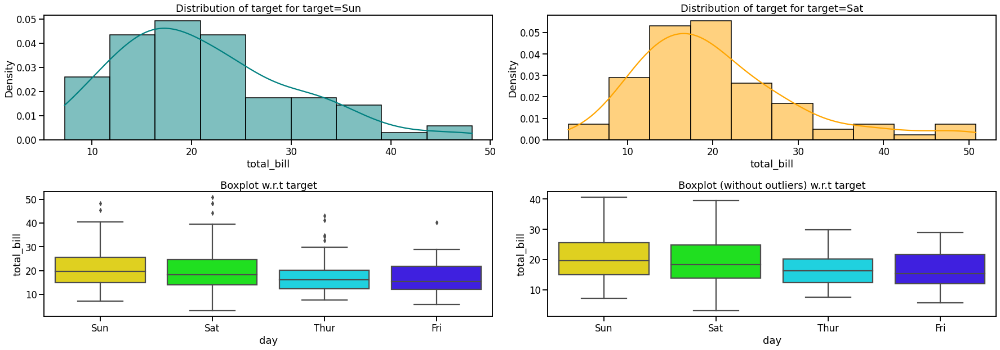

In [ ]:
# import plotly.express as px
df = px.data.tips()
distribution_plot_wrt_target(df, "total_bill", "day")

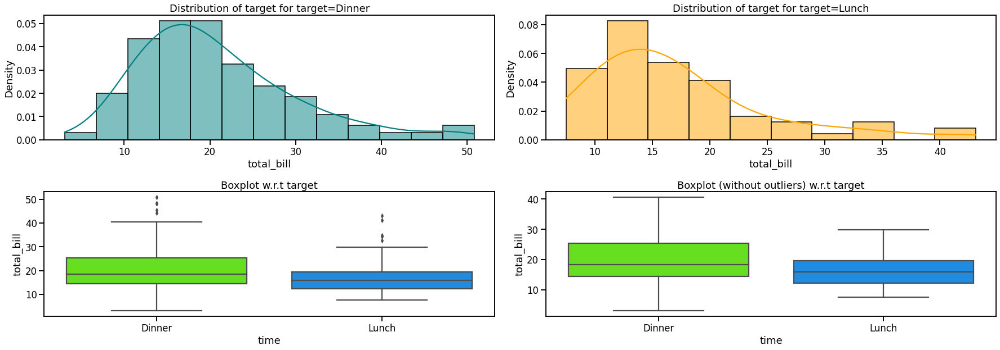

In [ ]:
# import plotly.express as px
df = px.data.tips()
distribution_plot_wrt_target(df, "total_bill", "time")

image.png

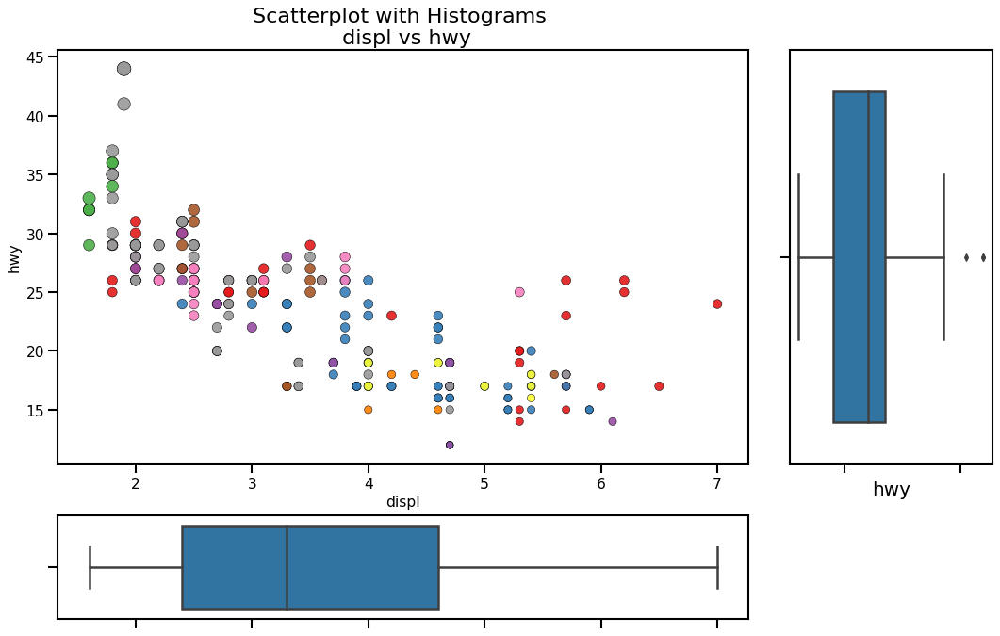

In [ ]:
# Import Data
df = pd.read_csv("https://raw.githubusercontent.com/selva86/datasets/master/mpg_ggplot2.csv")

# Create Fig and gridspec
fig = plt.figure(figsize=(16, 10), dpi= 80)
grid = plt.GridSpec(4, 4, hspace=0.5, wspace=0.2)

# Define the axes
ax_main = fig.add_subplot(grid[:-1, :-1])
ax_right = fig.add_subplot(grid[:-1, -1], xticklabels=[], yticklabels=[])
ax_bottom = fig.add_subplot(grid[-1, 0:-1], xticklabels=[], yticklabels=[])

# Scatterplot on main ax
ax_main.scatter('displ', 'hwy', s=df.cty*5, c=df.manufacturer.astype('category').cat.codes, alpha=.9, data=df, cmap="Set1", edgecolors='black', linewidths=.5)

# Add a graph in each part
sns.boxplot(df.hwy, ax=ax_right, orient="v")
sns.boxplot(df.displ, ax=ax_bottom, orient="h")

# Decorations ------------------
# Remove x axis name for the boxplot
ax_bottom.set(xlabel='')
ax_right.set(ylabel='')

# Main Title, Xlabel and YLabel
ax_main.set(title='Scatterplot with Histograms \n displ vs hwy', xlabel='displ', ylabel='hwy')

# Set font size of different components
ax_main.title.set_fontsize(20)
for item in ([ax_main.xaxis.label, ax_main.yaxis.label] + ax_main.get_xticklabels() + ax_main.get_yticklabels()):
    item.set_fontsize(14)

plt.show()


image.png


### Violin Plots

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.violin(df, y="tip", x="smoker", color="sex", box=True, points="all", hover_data=df.columns)
fig.show()

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.violin(df, y="tip", x="day", color="sex", box=True, points="all", hover_data=df.columns)
fig.show()

image.png

### Histogram

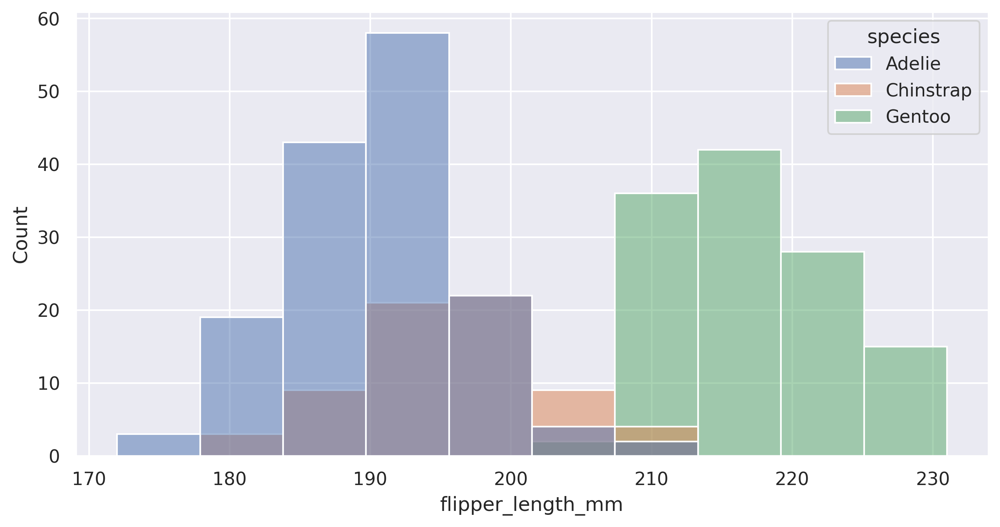

In [ ]:
data = sns.load_dataset("penguins")
sns.histplot(data=data, x="flipper_length_mm", hue="species");

sns.set_theme()
# For the image quality of the graphic. 
sns.set(rc={"figure.dpi":300})
# For the size of the graphics
sns.set(rc = {"figure.figsize":(10,5)})

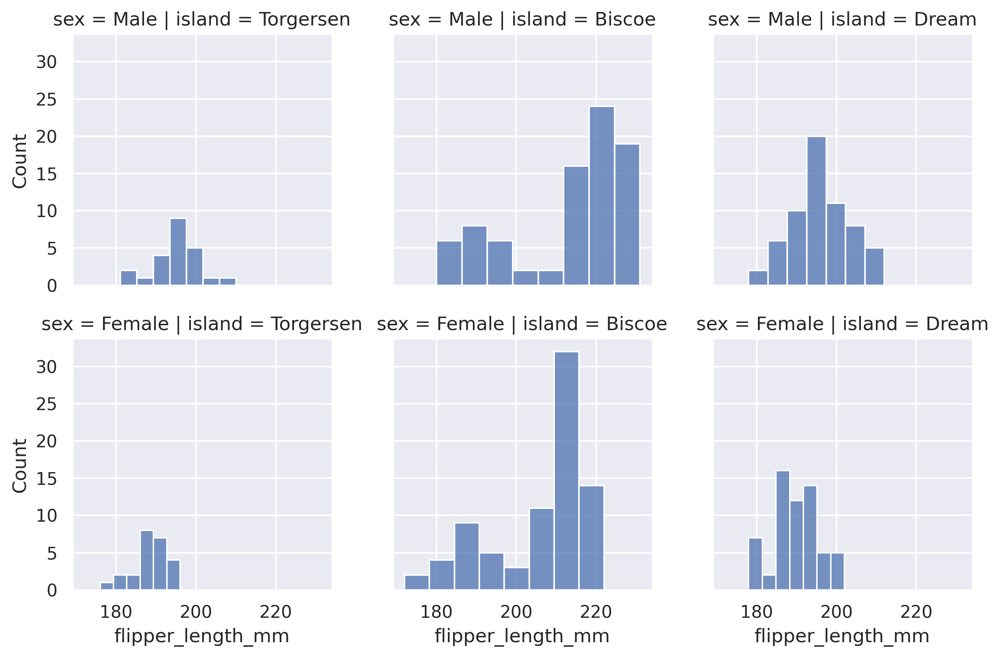

In [ ]:
sns.FacetGrid(data, col="island", row="sex").map(sns.histplot, "flipper_length_mm");

image.png

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.histogram(df, x="total_bill", y="tip", color="sex",
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

In [ ]:
import plotly.figure_factory as ff
import numpy as np

# Add histogram data
x1 = np.random.randn(200) - 2
x2 = np.random.randn(200)
x3 = np.random.randn(200) + 2
x4 = np.random.randn(200) + 4

# Group data together
hist_data = [x1, x2, x3, x4]

group_labels = ['Group 1', 'Group 2', 'Group 3', 'Group 4']

# Create distplot with custom bin_size
fig = ff.create_distplot(hist_data, group_labels, bin_size=.2)
fig.show()

In [ ]:
import plotly.figure_factory as ff
import numpy as np

# Add histogram data
x1 = np.random.randn(200)-2
x2 = np.random.randn(200)
x3 = np.random.randn(200)+2
x4 = np.random.randn(200)+4

# Group data together
hist_data = [x1, x2, x3, x4]

group_labels = ['Group 1', 'Group 2', 'Group 3', 'Group 4']

# Create distplot with custom bin_size
fig = ff.create_distplot(hist_data, group_labels, bin_size=[.1, .25, .5, 1])
fig.show()


In [ ]:
import plotly.figure_factory as ff
import numpy as np

x1 = np.random.randn(200)
x2 = np.random.randn(200) + 2

group_labels = ['Group 1', 'Group 2']

colors = ['slategray', 'magenta']

# Create distplot with curve_type set to 'normal'
fig = ff.create_distplot([x1, x2], group_labels, bin_size=.5,
                         curve_type='normal', # override default 'kde'
                         colors=colors)

# Add title
fig.update_layout(title_text='Distplot with Normal Distribution')
fig.show()

image.png

## Area Plots

### An area plot, also known as a stacked area chart or a stacked area graph, is a type of data visualization that is used to represent changes in numerical values over time. It is a graph that shows the trend of the cumulative values of multiple variables, each represented by a different color, stacked on top of one another.

### In an area plot, the area below the line connecting the values is filled with color, making it easy to see the relative contribution of each variable to the total value at each point in time. The x-axis typically represents time or a continuous variable, while the y-axis shows the numerical values being measured.

### Area plots are useful for comparing changes in the total value and the contribution of individual variables to that value over time. They are often used in finance, economics, and other fields where it is important to analyze trends and changes in data over time.

### When do we use Area Plots

### Area plots are commonly used in situations where it is important to display changes in multiple variables over time or across different categories. Here are some examples of when area plots may be useful:

### `Finance and economics`: Area plots can be used to show changes in stock prices, market indices, or other financial data over time, and how these changes are affected by different factors.


### `Climate and environmental data`: Area plots can help to display changes in temperature, rainfall, or other environmental data over time, and how different factors such as location or season impact these changes.

### `Marketing and sales`: Area plots can be used to show changes in sales revenue, market share, or other marketing metrics over time, and how these changes are influenced by different marketing strategies.

### `Health and medicine`: Area plots can be used to display changes in disease prevalence or treatment outcomes over time, and how these changes are affected by different interventions or risk factors.

### `Note`

### In general, area plots can be useful in any situation where it is important to display changes in multiple variables over time or across different categories, and to understand how these changes are influenced by different factors.

### Advantages


- ### They are effective for displaying trends and changes in multiple variables over time, making it easy to see the contribution of each variable to the total value.

- ### They can help to visualize patterns and correlations that may not be apparent in other types of graphs, such as line charts.

- ### They can be visually appealing and can effectively communicate complex information to a broad audience.

### Disadvantages

- ### They can be difficult to interpret accurately if the data series are too complex or have too many variables, making it challenging to identify specific trends or changes in individual variables.

- ### They can be misleading if the data series are not normalized or the y-axis scale is not consistent across all variables.

- ### They may not be suitable for data with large fluctuations or high variability, as the overlapping areas of the stacked variables can make it challenging to interpret the changes in individual variables.


### In summary, while area plots can be an effective tool for visualizing trends and changes in multiple variables over time, it's essential to consider their limitations and ensure that the data is suitable for this type of visualization before using it.

### Applications of Area Plots

In [ ]:
path="https://raw.githubusercontent.com/hayfordosmandata/DataBank/main/Car_price_area.csv"

In [ ]:
df=pd.read_csv(path)

In [ ]:
area=df[["body_style","wheel_base","city_mpg","highway_mpg","compression_ratio", "length","width"]]
area.head(3)

,body_style,wheel_base,city_mpg,highway_mpg,compression_ratio,length,width
0,convertible,88.6,21,27,9.0,168.8,64.1
1,convertible,88.6,21,27,9.0,168.8,64.1
2,hatchback,94.5,19,26,9.0,171.2,65.5


In [ ]:
area.set_index("body_style", inplace=True)
area.head(4)

,wheel_base,city_mpg,highway_mpg,compression_ratio,length,width
body_style,,,,,,
convertible,88.6,21,27,9.0,168.8,64.1
convertible,88.6,21,27,9.0,168.8,64.1
hatchback,94.5,19,26,9.0,171.2,65.5
sedan,99.8,24,30,10.0,176.6,66.2


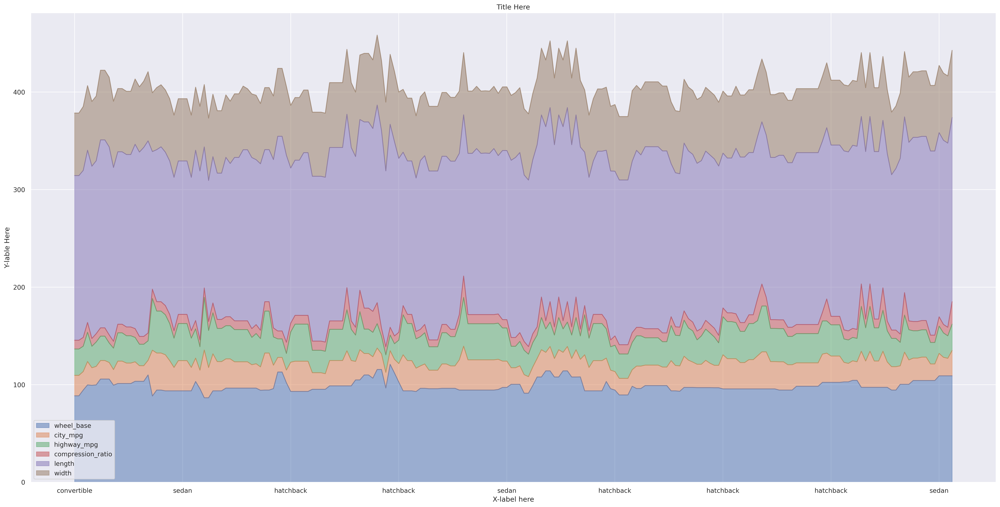

In [ ]:
area.plot(kind="area",alpha=0.5,figsize=(30,15))
plt.title("Title Here")
plt.ylabel("Y-lable Here")
plt.xlabel("X-label here")
plt.show()

In [ ]:
area.head(4)

,wheel_base,city_mpg,highway_mpg,compression_ratio,length,width
body_style,,,,,,
convertible,88.6,21,27,9.0,168.8,64.1
convertible,88.6,21,27,9.0,168.8,64.1
hatchback,94.5,19,26,9.0,171.2,65.5
sedan,99.8,24,30,10.0,176.6,66.2


In [ ]:
area2=df[["body_style","wheel_base","city_mpg","highway_mpg","compression_ratio", "length","width"]]
area2.head(4)

,body_style,wheel_base,city_mpg,highway_mpg,compression_ratio,length,width
0,convertible,88.6,21,27,9.0,168.8,64.1
1,convertible,88.6,21,27,9.0,168.8,64.1
2,hatchback,94.5,19,26,9.0,171.2,65.5
3,sedan,99.8,24,30,10.0,176.6,66.2


In [ ]:
area2.set_index("body_style", inplace=True)
area2.head()

,wheel_base,city_mpg,highway_mpg,compression_ratio,length,width
body_style,,,,,,
convertible,88.6,21,27,9.0,168.8,64.1
convertible,88.6,21,27,9.0,168.8,64.1
hatchback,94.5,19,26,9.0,171.2,65.5
sedan,99.8,24,30,10.0,176.6,66.2
sedan,99.4,18,22,8.0,176.6,66.4


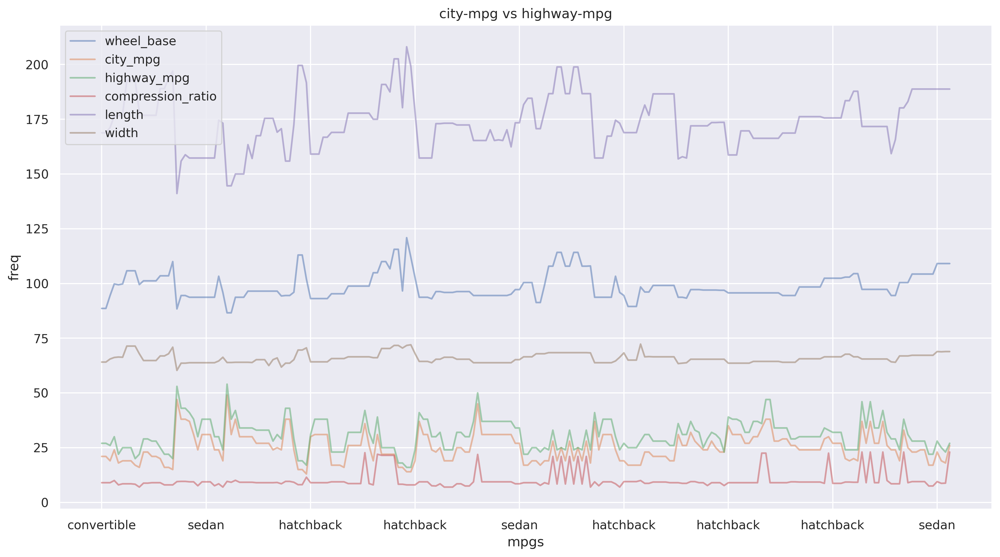

In [ ]:

area2.plot(kind="line",alpha=0.5,figsize=(15,8))
plt.title("city-mpg vs highway-mpg")
plt.ylabel("freq")
plt.xlabel("mpgs")

plt.show()

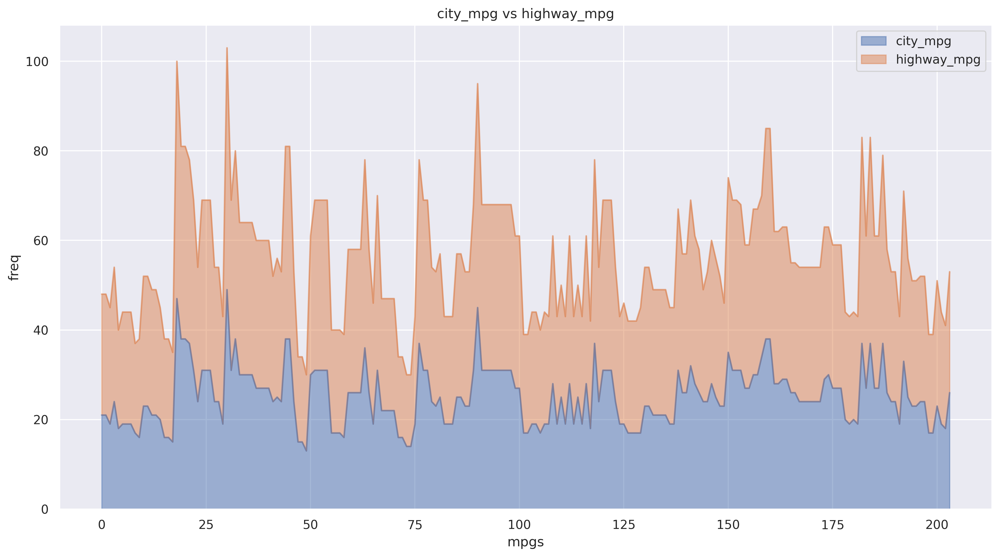

In [ ]:
df[["city_mpg","highway_mpg"]].plot(kind="area",alpha=0.5,figsize=(15,8))
plt.title("city_mpg vs highway_mpg")
plt.ylabel("freq")
plt.xlabel("mpgs")

plt.show()

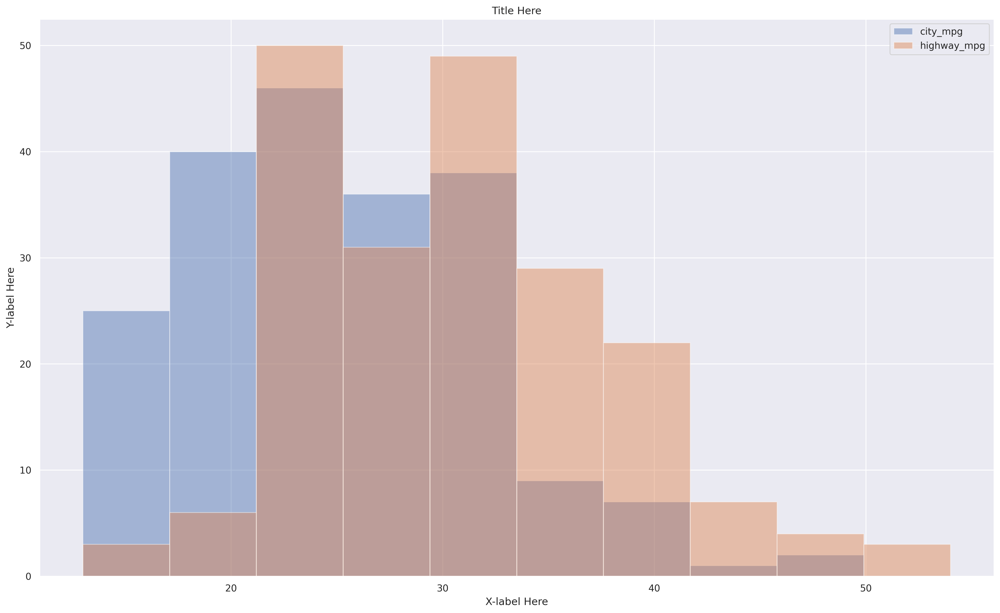

In [ ]:
df[["city_mpg","highway_mpg"]].plot(kind="hist",alpha=0.45,figsize=(20,12))
plt.title("Title Here")
plt.ylabel("Y-label Here")
plt.xlabel("X-label Here")
plt.show()

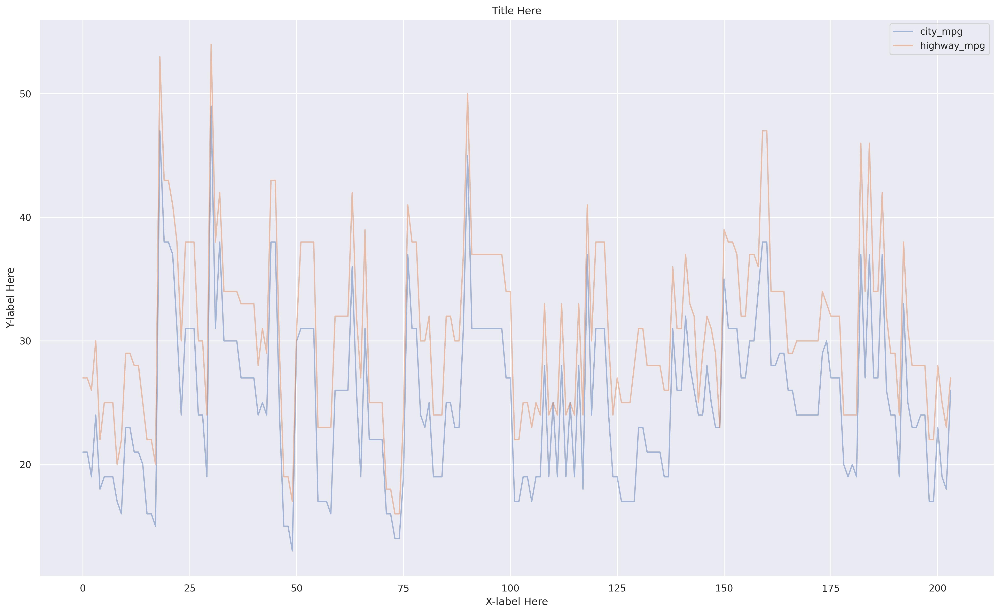

In [ ]:
df[["city_mpg","highway_mpg"]].plot(kind="line",alpha=0.45,figsize=(20,12))
plt.title("Title Here")
plt.ylabel("Y-label Here")
plt.xlabel("X-label Here")
plt.show()

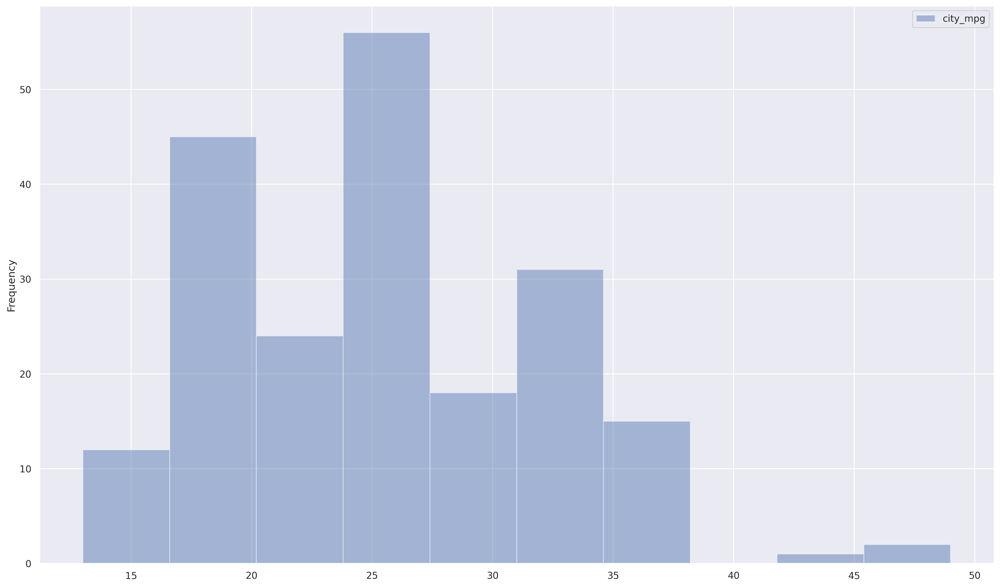

In [ ]:
df[["city_mpg"]].plot(kind="hist", alpha=0.45,figsize=(20,12))
plt.show()

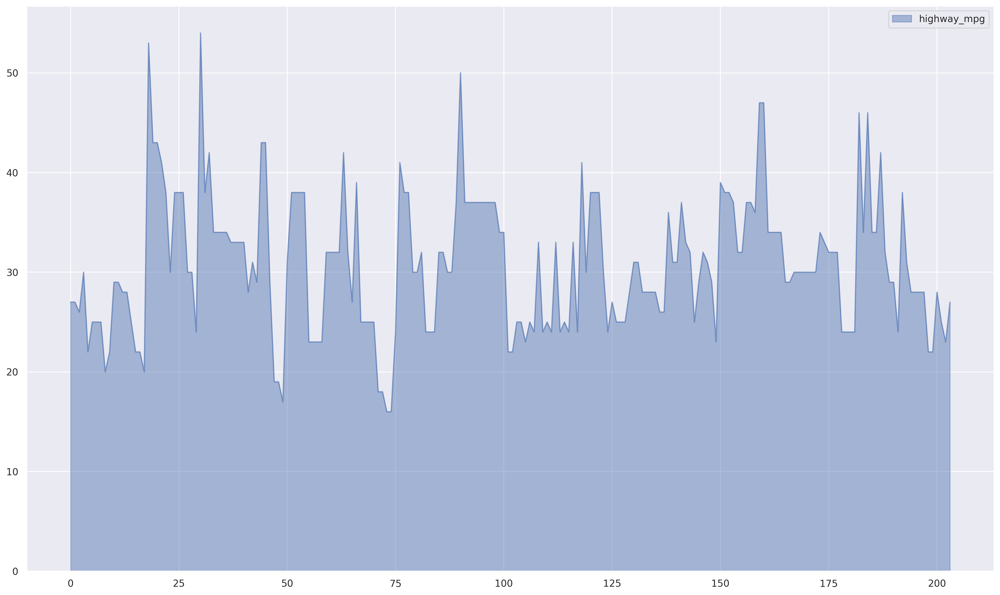

In [ ]:
df[["highway_mpg"]].plot(kind="area",alpha=0.45,figsize=(20,12))
plt.show()

In [ ]:
d={"years":[1990,1991,1992,1993,1995],"pop":[100,200,500,800,452],"gdp":[564,452,785,984,351]}
df2=pd.DataFrame(d)
df2

,years,pop,gdp
0,1990,100,564
1,1991,200,452
2,1992,500,785
3,1993,800,984
4,1995,452,351


In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt

In [ ]:
df2.set_index("years",inplace=True)

In [ ]:
df2

,pop,gdp
years,,
1990,100,564
1991,200,452
1992,500,785
1993,800,984
1995,452,351


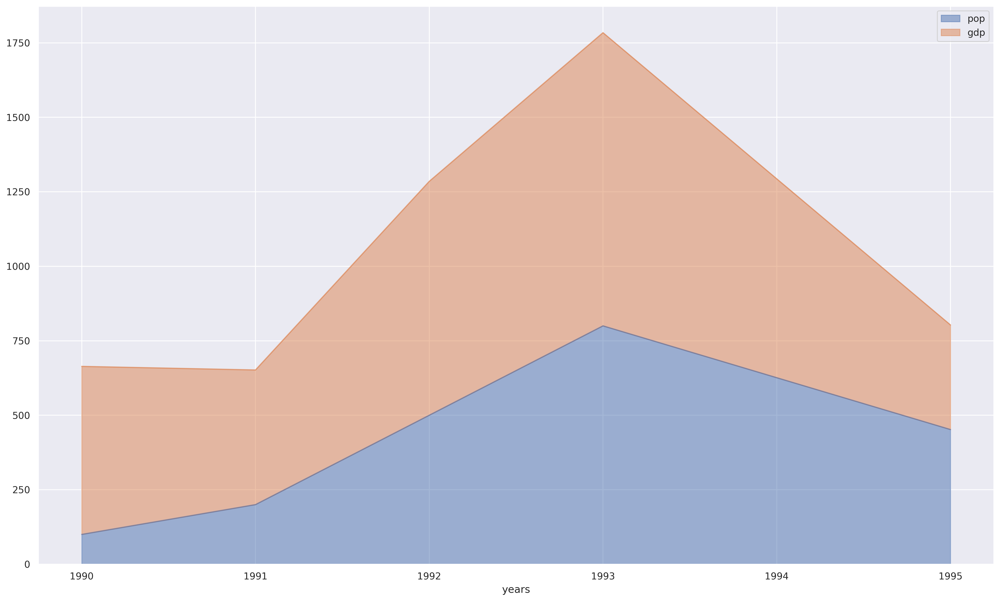

In [ ]:
df2[["pop","gdp"]].plot(kind="area",alpha=0.5,figsize=(20,12));

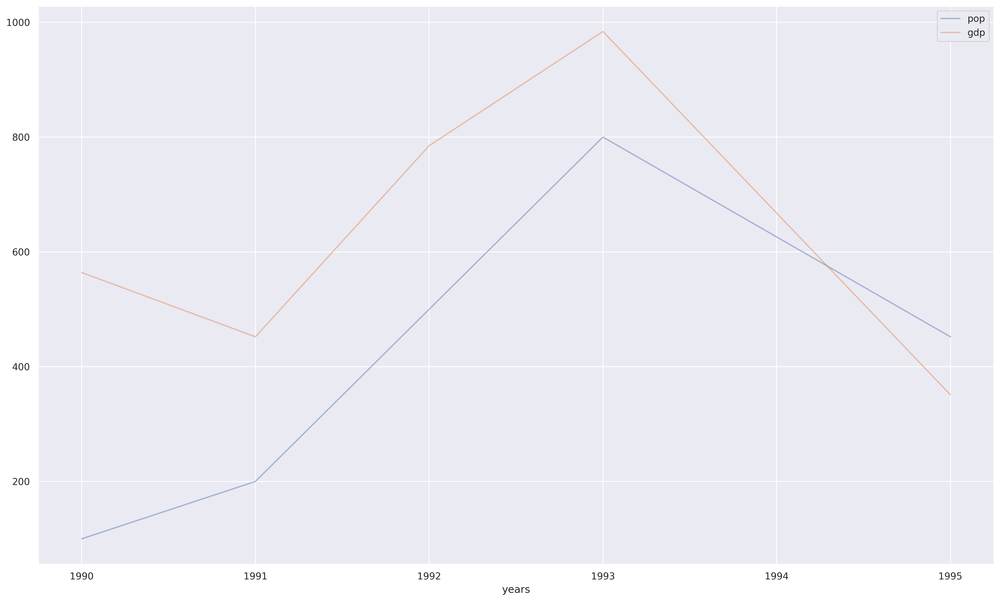

In [ ]:
df2[["pop","gdp"]].plot(kind="line",alpha=0.45,figsize=(20,12));

In [ ]:
df3=df2[["pop","gdp"]]
df3

,pop,gdp
years,,
1990,100,564
1991,200,452
1992,500,785
1993,800,984
1995,452,351


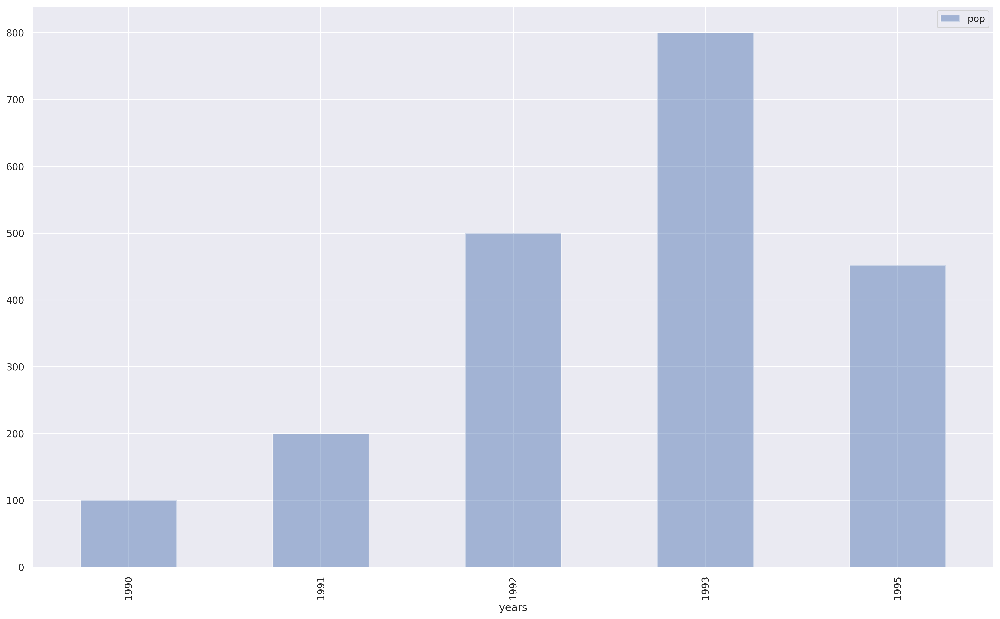

In [ ]:
df3[["pop"]].plot(kind="bar" ,alpha=0.45,figsize=(20,12));

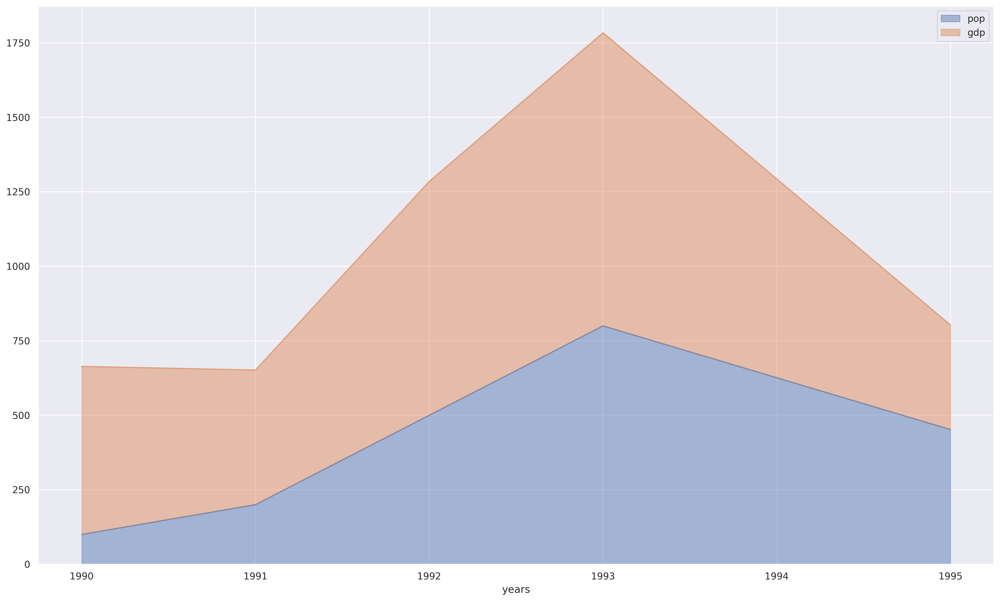

In [ ]:
df2[["pop","gdp"]].plot(kind="area",alpha=0.45,figsize=(20,12));

image.png

# <h1><left><font size=10><a name='link6'>6.0:Correlation Plots</a></center></font></h1>

## Correlations

### `Correlation` is a statistical measure that describes the relationship between two variables. It is a measure of how closely related two variables are, and how they tend to move together.

### The correlation coefficient, often denoted by the symbol "r," is a number that ranges between -1 and +1, where -1 indicates a perfect negative correlation (i.e., as one variable increases, the other variable decreases), +1 indicates a perfect positive correlation (i.e., as one variable increases, the other variable also increases), and 0 indicates no correlation (i.e., the two variables are unrelated).

### The correlation coefficient is calculated by dividing the covariance of the two variables by the product of their standard deviations. A positive correlation coefficient means that the two variables tend to move in the same direction, while a negative correlation coefficient means that the two variables tend to move in opposite directions.

### Correlation is an important concept in statistics and data analysis, as it can help researchers to understand the relationship between different variables, and to make predictions or test hypotheses about how changes in one variable may affect another. However, it is important to note that correlation does not imply causation, and that other factors may be responsible for the relationship between two variables.

### `When to use Correlation in Data Visualizations`

- ### Correlation is commonly used in data analysis and research to determine the relationship between two variables. Here are some situations where correlation is used:

- ### `Understanding relationships`: Correlation can be used to understand the nature and strength of the relationship between two variables. By calculating the correlation coefficient, you can determine whether the variables are positively or negatively related, and how strong the relationship is.

- ### `Predictive modeling`: Correlation can be used to create predictive models, where one variable is used to predict the other. For example, if you have data on sales and advertising spend, you can use correlation to determine how changes in advertising spend are likely to affect sales.

- ### `Hypothesis testing`: Correlation can be used to test hypotheses about the relationship between two variables. For example, if you hypothesize that there is a positive relationship between temperature and ice cream sales, you can use correlation to test this hypothesis.

- ### `Data cleaning`: Correlation can be used to identify errors and outliers in a dataset. If you have a large dataset, you can use correlation to identify values that are significantly different from the rest of the data.

### Overall, correlation is a useful tool for understanding the relationship between two variables, and can be used in a variety of situations, from predictive modeling to hypothesis testing. However, it is important to remember that correlation does not imply causation, and that other factors may be responsible for the relationship between two variables.

### Advantages of using correlation include:

- #### `Quantifying relationships`: Correlation provides a quantitative measure of the relationship between two variables. This can help you better understand the strength and direction of the relationship.

- #### `Predictive power`: Correlation can be used to create predictive models, where one variable is used to predict the other. This can be useful for making forecasts or identifying trends.

- #### `Hypothesis testing`: Correlation can be used to test hypotheses about the relationship between two variables. This can help you determine whether there is a statistically significant relationship between the variables.

- #### `Data cleaning`: Correlation can be used to identify outliers and errors in a dataset. This can be helpful for cleaning and preparing data for further analysis.

### Disadvantages of using correlation include:

- #### `Causation`: Correlation does not imply causation. Just because two variables are correlated does not mean that one causes the other.

- #### `Spurious correlations`: Correlation can sometimes identify spurious relationships between variables that are not actually related. This can be a problem when interpreting the results.

- #### `Sample size`: Correlation can be affected by the size of the sample. Small samples may produce unreliable correlation coefficients.

- #### `Nonlinear relationships`: Correlation is most useful for identifying linear relationships between two variables. If the relationship is nonlinear, correlation may not be the best tool to use.

#### Overall, correlation is a useful tool for quantifying the relationship between two variables, but it has limitations and may not be suitable for all datasets. It is important to consider the advantages and disadvantages of correlation when deciding whether to use it for your data analysis. Additionally, it's important to keep in mind that correlation is only one tool in the data analyst's toolkit, and should be used in conjunction with other statistical and analytical methods.

image.png

### Correlation Plots Frequently Used

## Correlation Matrix



### A `correlation matrix` is a table that displays the correlation coefficients between pairs of variables in a dataset. Each row and column in the matrix represents a different variable, and the cells contain the correlation coefficient between the two variables represented by that row and column. The diagonal of the matrix contains the correlation coefficient of each variable with itself, which is always equal to 1.

### The correlation coefficient is a statistical measure that indicates the strength and direction of the relationship between two variables. The coefficient can range from -1 to 1, where -1 indicates a perfect negative correlation, 0 indicates no correlation, and 1 indicates a perfect positive correlation.

### Correlation matrices are often used to identify which variables are strongly correlated with each other. This can be useful for a variety of data analysis tasks, including feature selection, data visualization, and modeling. Correlation matrices can also help identify potential issues with multicollinearity, where two or more variables in a regression model are highly correlated with each other, which can lead to unstable estimates of the regression coefficients.

### Overall, correlation matrices are a useful tool for exploring the relationships between variables in a dataset, and can provide valuable insights into the structure of the data.

###  Applications of Correlation Matrix

In [ ]:
# importing the dataset
import pandas as pd
url="https://raw.githubusercontent.com/hayfordosmandata/DataBank/main/Diabetes_1.csv"
df=pd.read_csv(url, encoding="unicode_escape")

# First 4 rows of the dataset
df.head(4)

,Pregnancies,Glucose,Blood Pressure,Skin Thickness,Insulin,BMI,Diabetes Pedigree Function,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0


image.png

##### Using Correlation Matrix` is a table that displays the correlation coefficients between pairs of numerical variables in a dataset.

In [ ]:
# Displaying correlation between numerical variables
df.corr()

,Pregnancies,Glucose,Blood Pressure,Skin Thickness,Insulin,BMI,Diabetes Pedigree Function,Age,Outcome
Pregnancies,1.000000,0.129459,0.141282,-0.081672,-0.073535,0.017683,-0.033523,0.544341,0.221898
Glucose,0.129459,1.000000,0.152590,0.057328,0.331357,0.221071,0.137337,0.263514,0.466581
Blood Pressure,0.141282,0.152590,1.000000,0.207371,0.088933,0.281805,0.041265,0.239528,0.065068
Skin Thickness,-0.081672,0.057328,0.207371,1.000000,0.436783,0.392573,0.183928,-0.113970,0.074752
Insulin,-0.073535,0.331357,0.088933,0.436783,1.000000,0.197859,0.185071,-0.042163,0.130548
BMI,0.017683,0.221071,0.281805,0.392573,0.197859,1.000000,0.140647,0.036242,0.292695
Diabetes Pedigree Function,-0.033523,0.137337,0.041265,0.183928,0.185071,0.140647,1.000000,0.033561,0.173844
Age,0.544341,0.263514,0.239528,-0.113970,-0.042163,0.036242,0.033561,1.000000,0.238356
Outcome,0.221898,0.466581,0.065068,0.074752,0.130548,0.292695,0.173844,0.238356,1.000000


## Heatmap

### A `Heatmap` is a graphical representation of data where the values are displayed as colors on a two-dimensional matrix. 

- ### Heatmaps are commonly used to visualize correlation between variables, and the colors represent the strength and direction of the correlation. 

- ### Heatmaps can also be used to identify patterns in the data and to highlight differences or similarities between different groups or categories. 

- ### Heatmaps are particularly useful when working with large datasets, as they can help identify patterns that may be difficult to see in raw data.

### Overall, the main difference between a pairplot and a heatmap is that a pairplot shows pairwise relationships between variables in a dataset, while a heatmap visualizes correlation between variables using colors on a two-dimensional matrix. Both visualizations can be useful for different types of data analysis tasks and can provide valuable insights into the data.





image.png

### Applications of Heatmaps

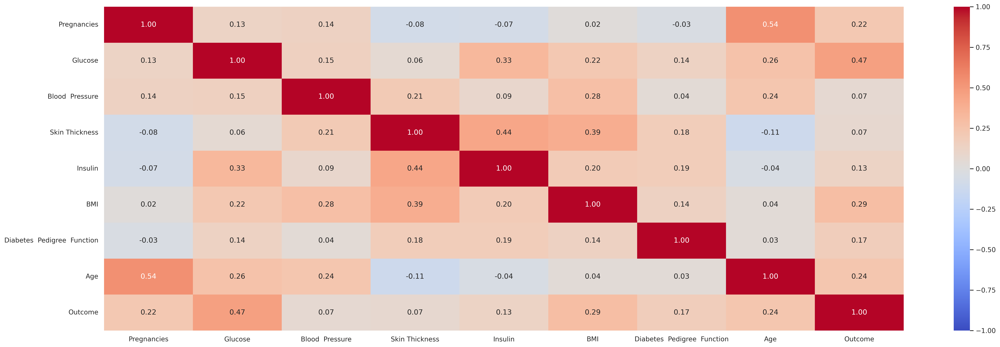

In [ ]:
# Displaying the correlation between numerical variables of the dataset
plt.figure(figsize=(30, 10))
sns.heatmap(df.corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="coolwarm")
plt.show()

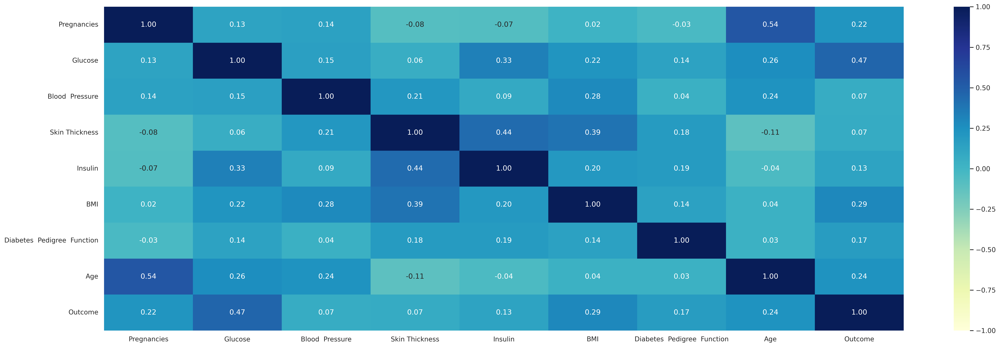

In [ ]:
# creates heatmap showing correlation of numeric columns in data
plt.figure(figsize=(30, 10))
sns.heatmap(df.corr(), vmin=-1, vmax=1, cmap="YlGnBu", annot=True, fmt=".2f");

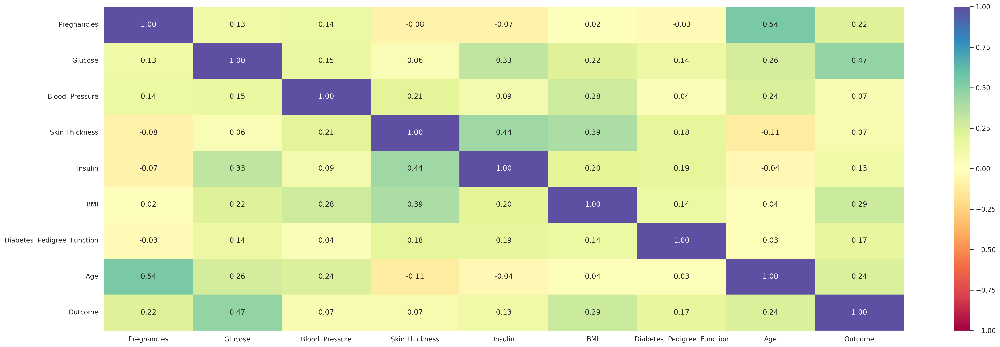

In [ ]:
cols_list = df.select_dtypes(include=np.number).columns.tolist()

plt.figure(figsize=(30, 10))
sns.heatmap(
    df[cols_list].corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="Spectral"
) ## Complete the code to find the correlation between the variables
plt.show()

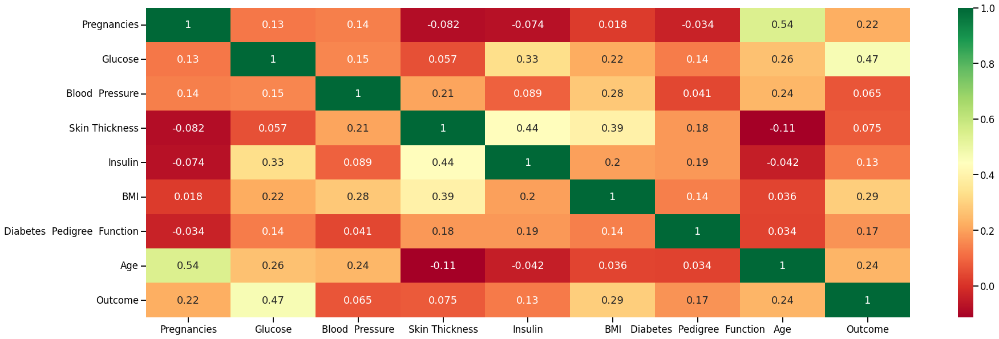

In [ ]:
# using heatmap
correlation = df.corr() # creating a 2-D Matrix with correlation plots
plt.figure(figsize=(30,10))
sns.heatmap(correlation, annot=True, cmap="RdYlGn");

In [ ]:
import plotly.express as px
data=[[1, 25, 30, 50, 1], [20, 1, 60, 80, 30], [30, 60, 1, 5, 20]]
fig = px.imshow(data,
                labels=dict(x="Day of Week", y="Time of Day", color="Productivity"),
                x=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday'],
                y=['Morning', 'Afternoon', 'Evening']
               )
fig.update_xaxes(side="top")
fig.show()

image.png

## Pair Plots

### Pairplot:

### A `pairplot` is a visualization that plots pairwise relationships between variables in a dataset. It creates scatterplots between all pairs of variables, and histograms for each variable along the diagonal of the plot. Pairplots are useful for visualizing the relationship between multiple variables at once and for identifying patterns or trends in the data. Pairplots can also highlight any correlation or association between variables, as well as any outliers or anomalies.

### Applications of PairPlots

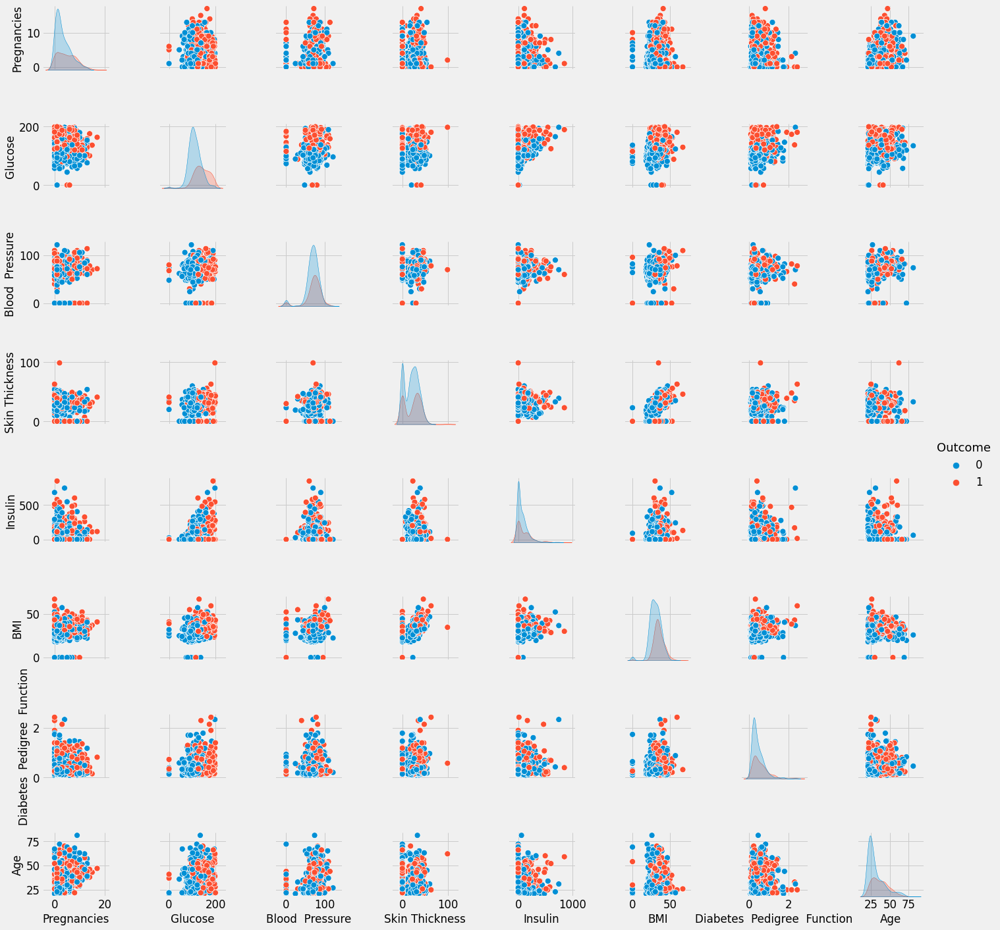

In [ ]:
plt.style.use('fivethirtyeight')
sns.pairplot(df, hue = 'Outcome', vars = df.columns[:8], diag_kind = 'kde');

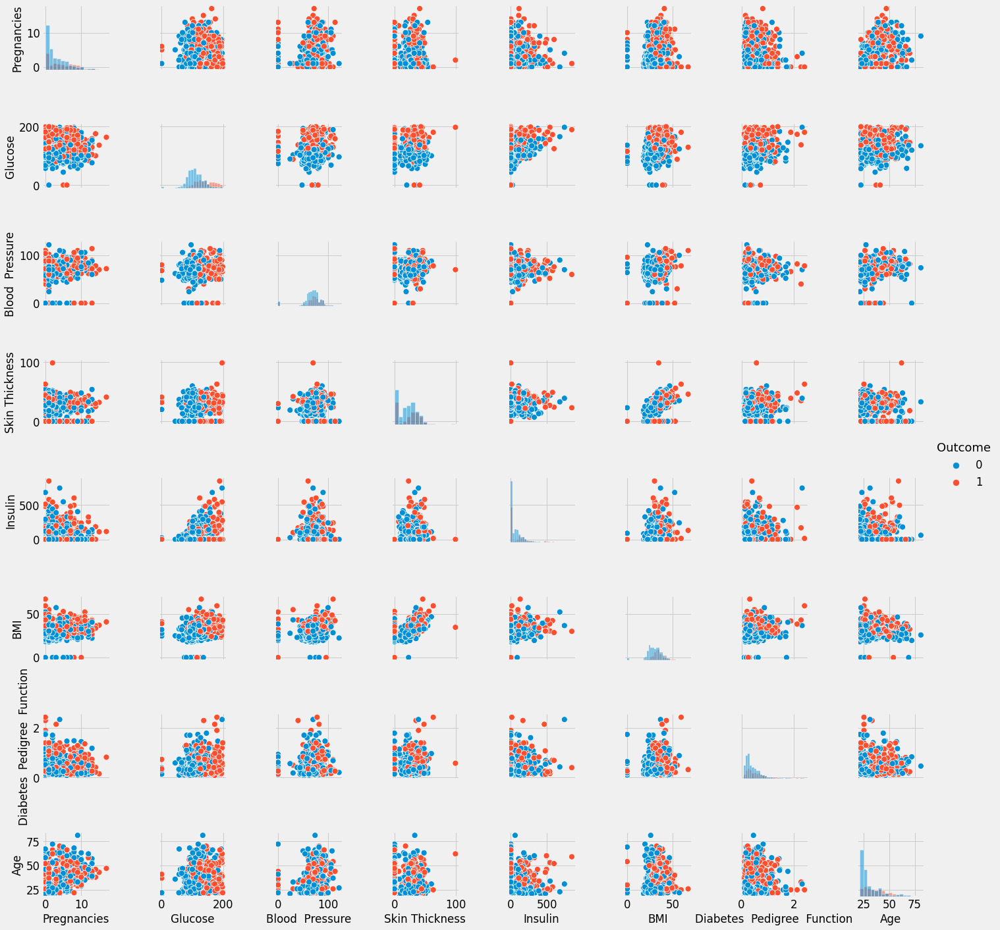

In [ ]:
import seaborn as sns

sns.pairplot(df , hue='Outcome' , diag_kind = 'hist',diag_kws=dict(fill=True))
plt.show()

image.png

In [ ]:
# correlation betweon one column and the rest
df.corr()['Outcome']

Pregnancies                     0.221898
Glucose                         0.466581
Blood  Pressure                 0.065068
Skin Thickness                  0.074752
Insulin                         0.130548
BMI                             0.292695
Diabetes  Pedigree  Function    0.173844
Age                             0.238356
Outcome                         1.000000
Name: Outcome, dtype: float64

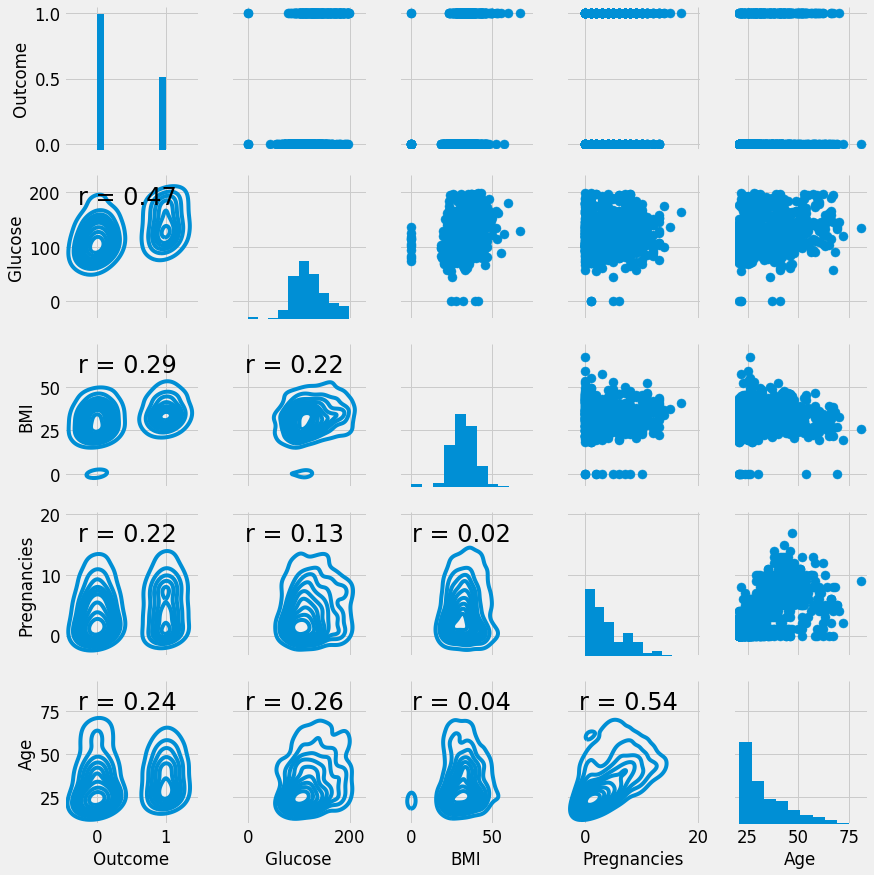

In [ ]:
import scipy

# Function to calculate correlation coefficient between two variables
def corrfunc(x, y, **kwgs):
    r = np.corrcoef(x, y)[0][1]
    ax = plt.gca()
    ax.annotate("r = {:.2f}".format(r),
                xy=(.1, .8), xycoords=ax.transAxes,
               size = 24)

# Create a PairGrid
g = sns.PairGrid(data = df,  
                 vars = ['Outcome', 'Glucose', 'BMI', 'Pregnancies', 'Age'])

# Map a scatterplot to the upper triangle
g.map_upper(plt.scatter)

# Map a histogram to the diagonal
g.map_diag(plt.hist)

# Map a kde plot to the lower triangle
g.map_lower(sns.kdeplot)

# Map the correlation coefficient to the lower diagonal
g.map_lower(corrfunc)

In [ ]:
data = sns.load_dataset("penguins")
data.head()

,species,island,bill_length_mm,bill_depth_mm,flipper_length_mm,body_mass_g,sex
0,Adelie,Torgersen,39.1,18.7,181.0,3750.0,Male
1,Adelie,Torgersen,39.5,17.4,186.0,3800.0,Female
2,Adelie,Torgersen,40.3,18.0,195.0,3250.0,Female
3,Adelie,Torgersen,NaN,NaN,NaN,NaN,NaN
4,Adelie,Torgersen,36.7,19.3,193.0,3450.0,Female


In [ ]:
sns.set_theme()
# For the image quality of the graphic. 
sns.set(rc={"figure.dpi":300})
# For the size of the graphics
sns.set(rc = {"figure.figsize":(5,3)})

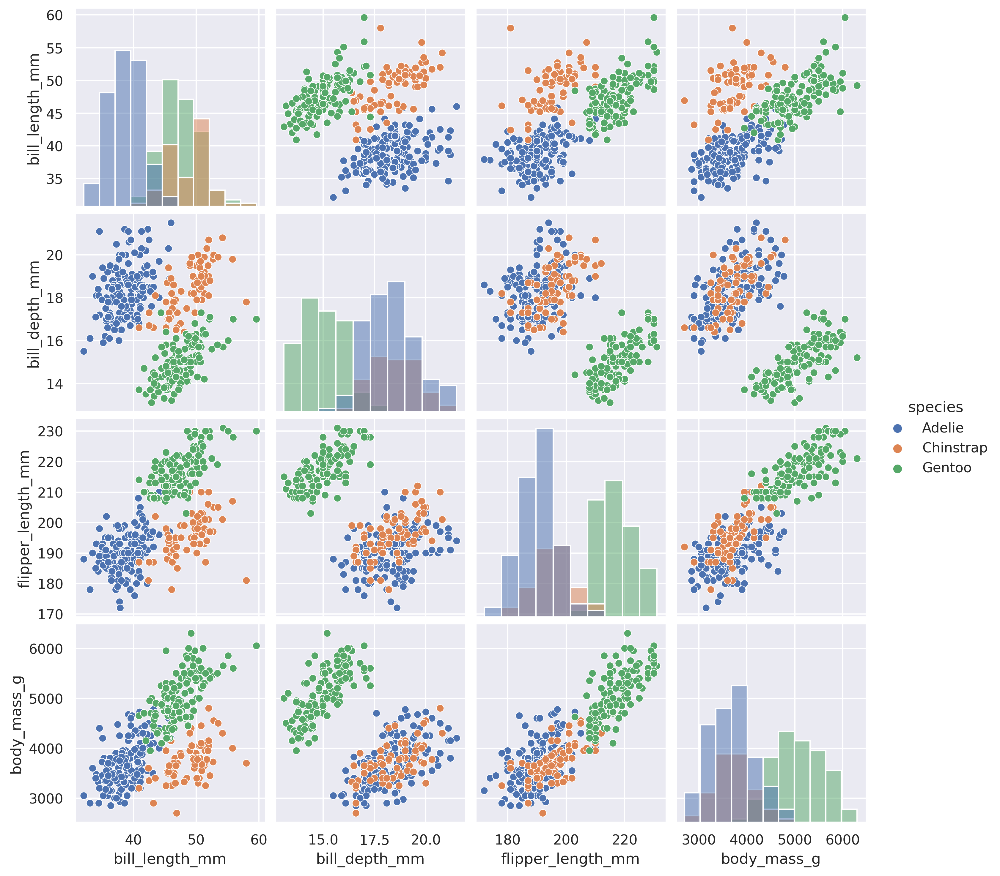

In [ ]:
sns.pairplot(data, hue="species", diag_kind="hist");

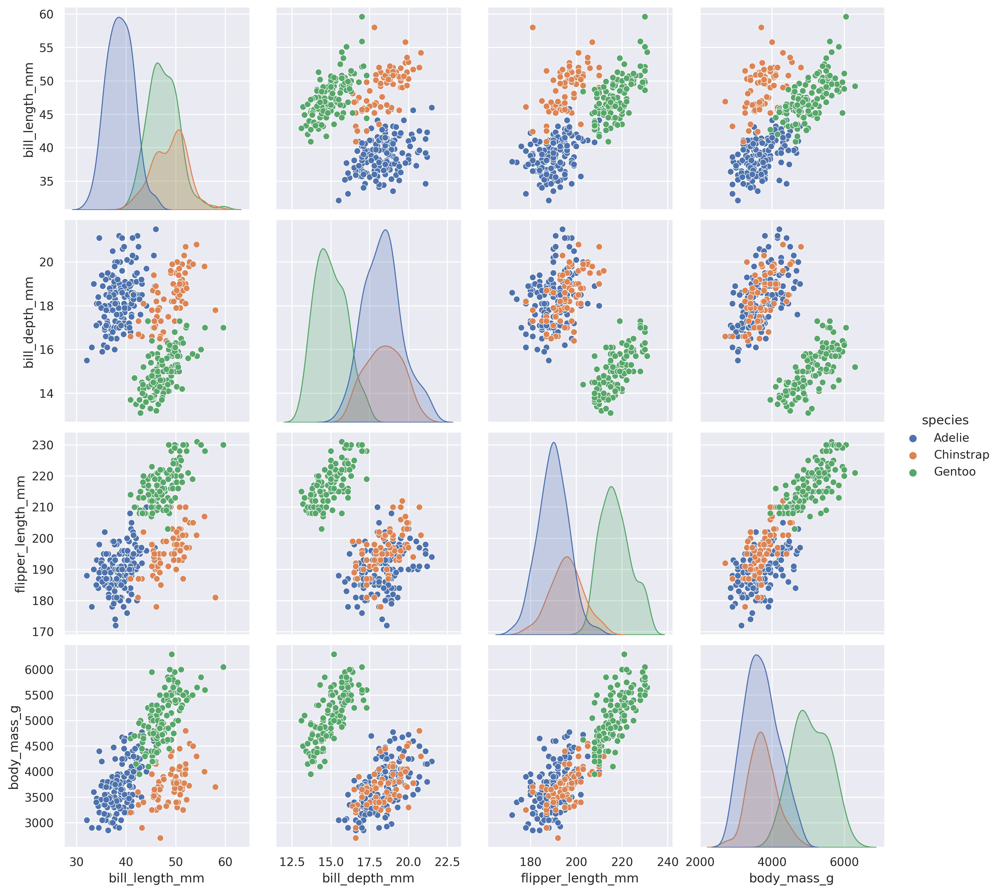

In [ ]:
sns.pairplot(data, hue="species", height=3);

<Figure size 1200x640 with 0 Axes>

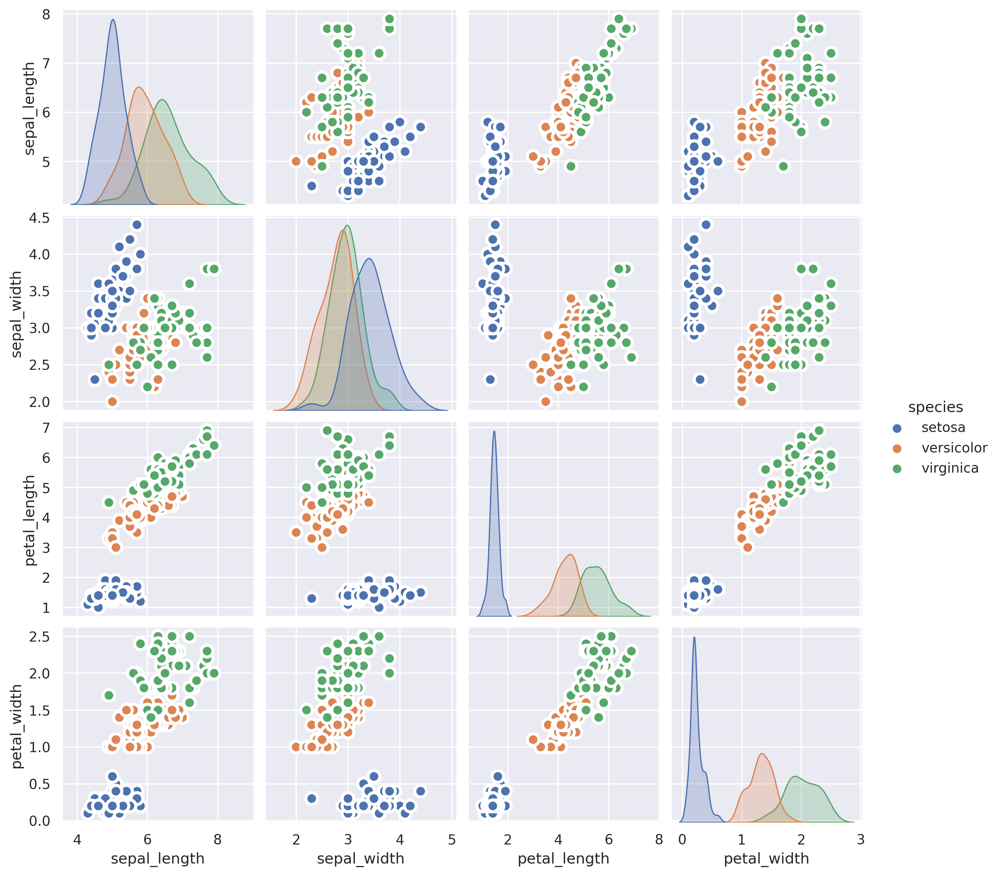

In [ ]:
# Load Dataset
df = sns.load_dataset('iris')

# Plot
plt.figure(figsize=(15,8), dpi= 80)
sns.pairplot(df, kind="scatter", hue="species", plot_kws=dict(s=90, edgecolor="white", linewidth=2.5))
plt.show();

image.png

## Scatter Plots

### A `scatter` plot is a type of graphical representation used to display the relationship between two continuous variables. It is a way of visualizing the correlation between two variables to determine whether there is a relationship or pattern between them. The scatter plot consists of a series of points on a two-dimensional plane, where each point represents the values of two variables, one plotted along the x-axis and the other plotted along the y-axis. The position of each point represents the value of the two variables for a particular observation.

### Scatter plots are commonly used in various fields such as statistics, data analysis, machine learning, and scientific research. They are often used to identify trends, patterns, clusters, or outliers in a dataset, and to understand the relationship between two variables. By examining the shape of the scatter plot, one can make conclusions about the strength and direction of the relationship between the two variables.

### When do we use Scatter Plots

- ### Scatter plots are commonly used in data analysis and statistical research to visualize the relationship between two continuous variables. Here are some situations where scatter plots are commonly used:

- #### `Identifying Patterns`: Scatter plots are useful for identifying patterns and trends in the data. By examining the scatter plot, you can determine whether there is a positive, negative, or no correlation between the variables.


- #### `Outlier Detection`: Scatter plots are also useful for identifying outliers in the data. Outliers are data points that fall outside the general pattern of the data, and they can have a significant impact on the results of statistical analysis. A scatter plot can help to identify these outliers.


- #### `Visualization`: Scatter plots are useful for visualizing large data sets. They allow you to see the distribution of the data and can help to identify clusters or subgroups within the data.


- #### `Hypothesis Testing`: Scatter plots are often used to test hypotheses about the relationship between two variables. By comparing the pattern of the data to a theoretical model, you can determine whether there is a statistically significant relationship between the variables.


### Overall, scatter plots are a useful tool for visualizing and analyzing the relationship between two continuous variables.

### Advantages of using scatter plots include:

- ### `Visualization`: Scatter plots are an effective way to visualize data and can help you quickly identify trends, patterns, and outliers.


- ### `Relationships`: Scatter plots can help you identify and quantify the relationship between two variables. You can use this information to make predictions or test hypotheses.


- ### `Clustering`: Scatter plots can be used to identify clusters or subgroups within the data. This information can be helpful in making decisions or identifying patterns.


- ### `Large datasets`: Scatter plots can be used to visualize large datasets, making it easier to understand the overall distribution of the data.


### Disadvantages of using scatter plots include:

### `Limited to two variables`: Scatter plots can only be used to visualize the relationship between two variables. If you have more than two variables, you will need to create additional scatter plots or use other visualization techniques.


### `Overplotting`: If you have a large number of data points, they can overlap and make it difficult to see the overall pattern in the data.

`Nonlinear relationships`: Scatter plots are most useful for identifying linear relationships between two variables. If the relationship is nonlinear, a scatter plot may not be the best tool to use.


### `Missing data`: If there are missing values in your dataset, it may not be possible to create a scatter plot for all observations.


### Overall, scatter plots are a useful tool for visualizing the relationship between two variables, but they have limitations and may not be suitable for all datasets. It is important to consider the advantages and disadvantages of scatter plots when deciding whether to use them for your data analysis.

image.png

### Practical Applications of Scatter Plots

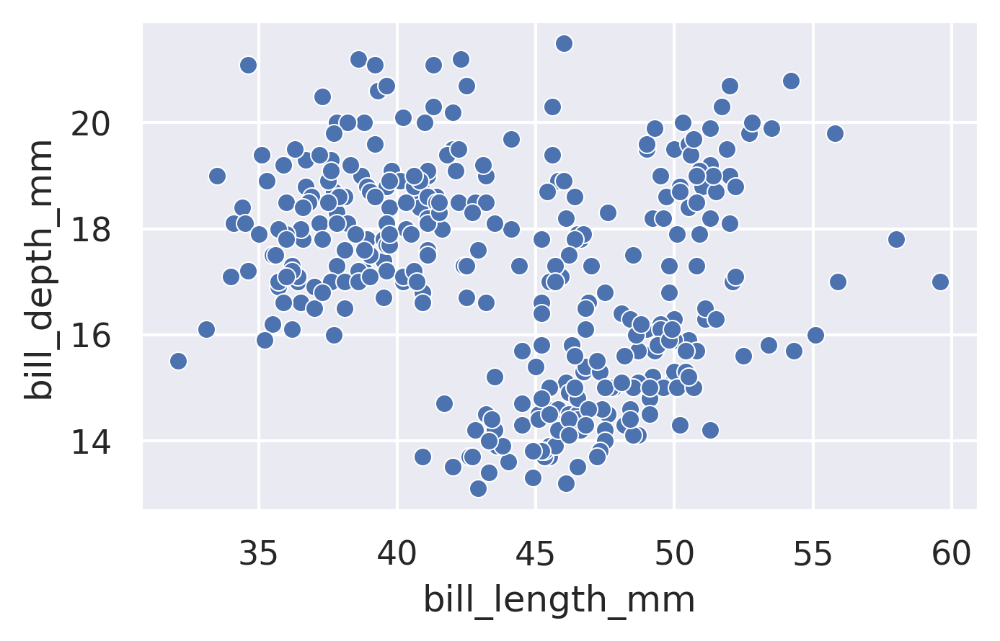

In [ ]:
# Scatter Plot of Bill lenght vs Bill Depth
sns.scatterplot( x = "bill_length_mm", 
                 y = "bill_depth_mm", 
                 data = data);

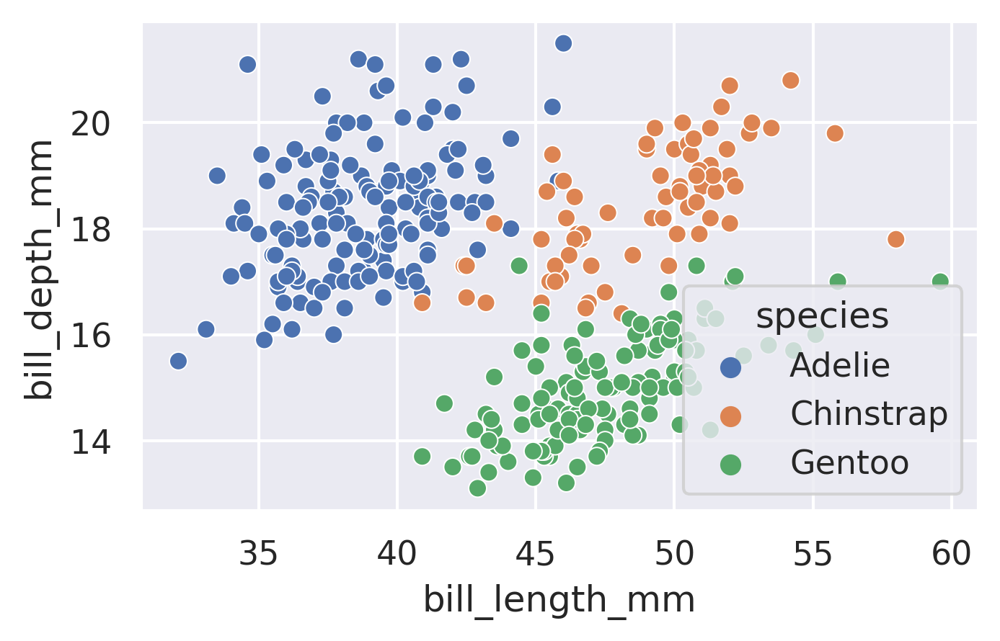

In [ ]:
# Scatter plot of Bill lenght vs Bill Depth respect to Species
sns.scatterplot( x = "bill_length_mm", 
                 y = "bill_depth_mm", 
                 data = data, 
                 hue = "species");

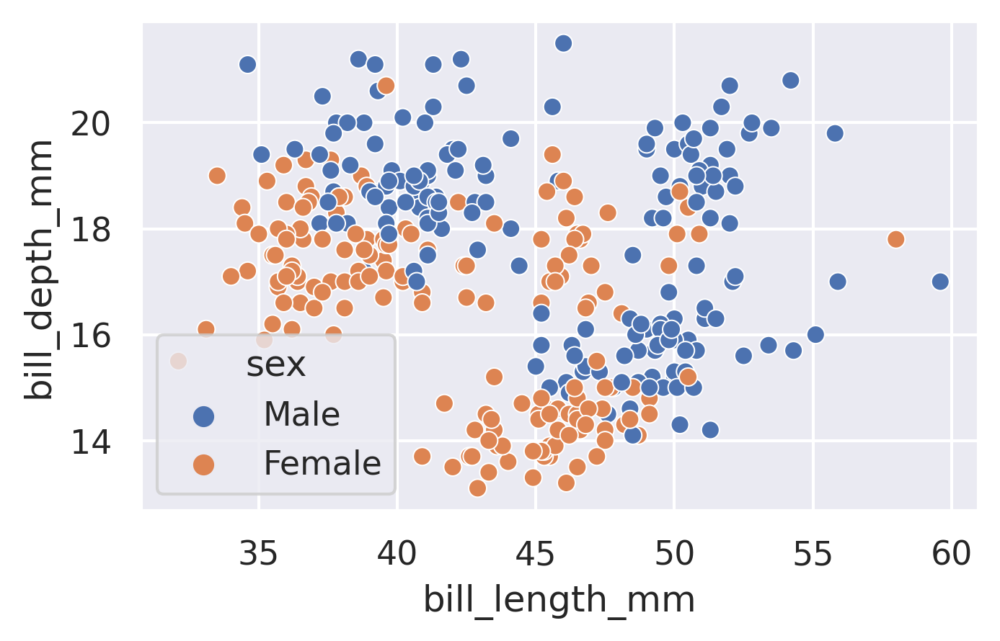

In [ ]:
# Scatter plot of Bill lenght vs Bill Depth respect to Sex
sns.scatterplot( x = "bill_length_mm", 
                 y = "bill_depth_mm", 
                 data = data, 
                 hue = "sex");

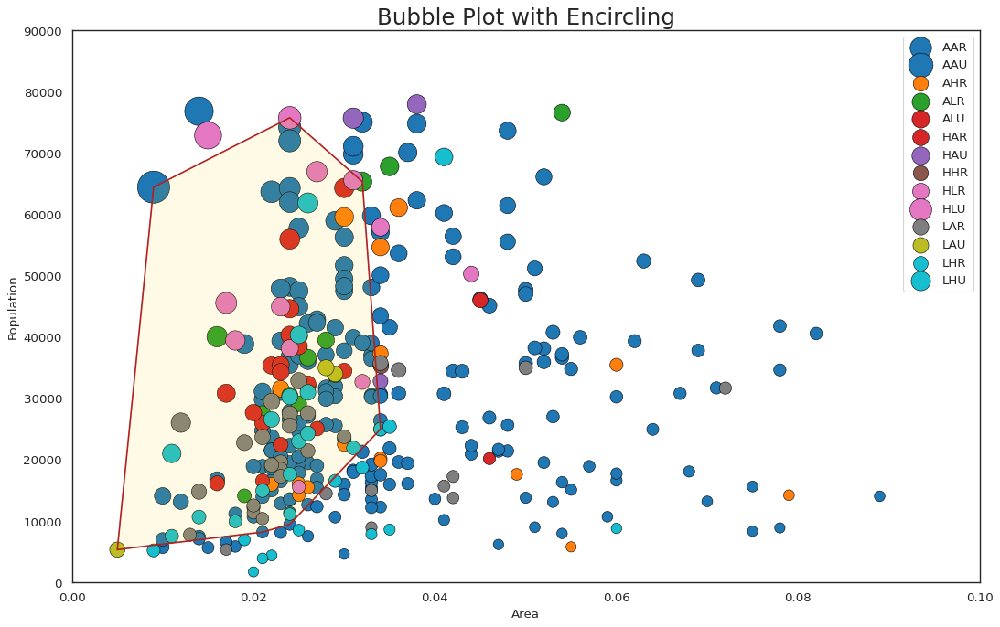

In [ ]:
from matplotlib import patches
from scipy.spatial import ConvexHull
import warnings; warnings.simplefilter('ignore')
sns.set_style("white")

# Step 1: Prepare Data
midwest = pd.read_csv("https://raw.githubusercontent.com/selva86/datasets/master/midwest_filter.csv")

# As many colors as there are unique midwest['category']
categories = np.unique(midwest['category'])
colors = [plt.cm.tab10(i/float(len(categories)-1)) for i in range(len(categories))]

# Step 2: Draw Scatterplot with unique color for each category
fig = plt.figure(figsize=(16, 10), dpi= 80, facecolor='w', edgecolor='k')    

for i, category in enumerate(categories):
    plt.scatter('area', 'poptotal', data=midwest.loc[midwest.category==category, :], s='dot_size', c=colors[i], label=str(category), edgecolors='black', linewidths=.5)

# Step 3: Encircling
# https://stackoverflow.com/questions/44575681/how-do-i-encircle-different-data-sets-in-scatter-plot
def encircle(x,y, ax=None, **kw):
    if not ax: ax=plt.gca()
    p = np.c_[x,y]
    hull = ConvexHull(p)
    poly = plt.Polygon(p[hull.vertices,:], **kw)
    ax.add_patch(poly)

# Select data to be encircled
midwest_encircle_data = midwest.loc[midwest.state=='IN', :]                         

# Draw polygon surrounding vertices    
encircle(midwest_encircle_data.area, midwest_encircle_data.poptotal, ec="k", fc="gold", alpha=0.1)
encircle(midwest_encircle_data.area, midwest_encircle_data.poptotal, ec="firebrick", fc="none", linewidth=1.5)

# Step 4: Decorations
plt.gca().set(xlim=(0.0, 0.1), ylim=(0, 90000),
              xlabel='Area', ylabel='Population')

plt.xticks(fontsize=12); plt.yticks(fontsize=12)
plt.title("Bubble Plot with Encircling", fontsize=22)
plt.legend(fontsize=12)    
plt.show();    

#####`Distribution of Iris Dataset`

In [ ]:
# Using Iris Dataset in Searbon
df = px.data.iris().head()
df

,sepal_length,sepal_width,petal_length,petal_width,species,species_id
0,5.1,3.5,1.4,0.2,setosa,1
1,4.9,3.0,1.4,0.2,setosa,1
2,4.7,3.2,1.3,0.2,setosa,1
3,4.6,3.1,1.5,0.2,setosa,1
4,5.0,3.6,1.4,0.2,setosa,1


In [ ]:
import plotly.express as px
df = px.data.iris()
fig = px.scatter(df, x="sepal_width", y="sepal_length", color="species", marginal_y="violin",
           marginal_x="box", trendline="ols", template="simple_white")
fig.show()

In [ ]:
import plotly.express as px
df = px.data.iris()
fig = px.scatter(df, x="sepal_width", y="sepal_length", color="species")
fig.show()

In [ ]:
import plotly.express as px
df = px.data.iris()
df["e"] = df["sepal_width"]/100
fig = px.scatter(df, x="sepal_width", y="sepal_length", color="species", error_x="e", error_y="e")
fig.show()

In [ ]:
import plotly.express as px
df = px.data.iris()
fig = px.scatter_matrix(df, dimensions=["sepal_width", "sepal_length", "petal_width", "petal_length"], color="species")
fig.show()

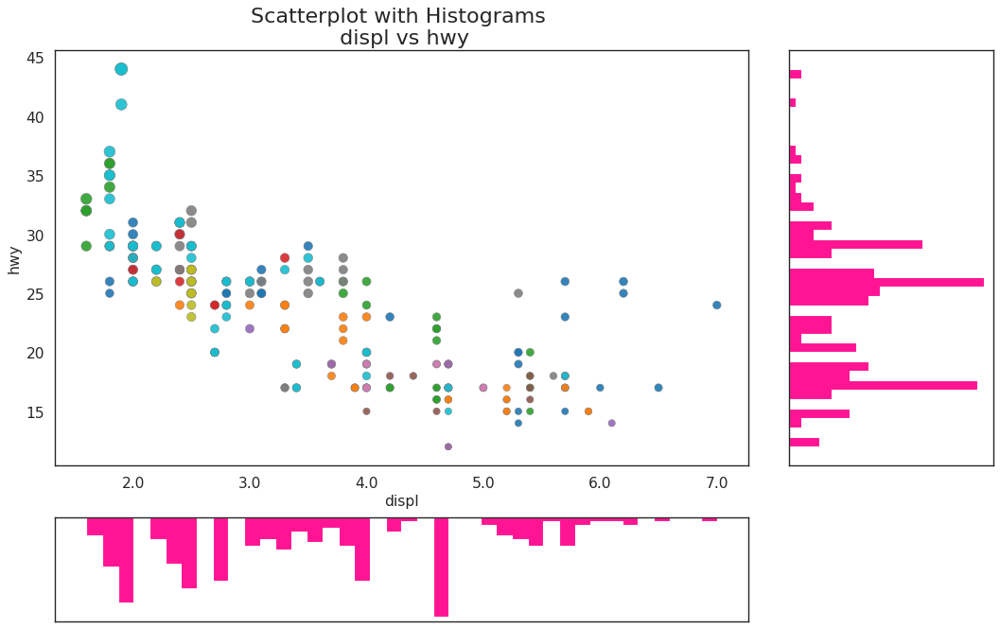

In [ ]:
# Import Data
df = pd.read_csv("https://raw.githubusercontent.com/selva86/datasets/master/mpg_ggplot2.csv")

# Create Fig and gridspec
fig = plt.figure(figsize=(16, 10), dpi= 80)
grid = plt.GridSpec(4, 4, hspace=0.5, wspace=0.2)

# Define the axes
ax_main = fig.add_subplot(grid[:-1, :-1])
ax_right = fig.add_subplot(grid[:-1, -1], xticklabels=[], yticklabels=[])
ax_bottom = fig.add_subplot(grid[-1, 0:-1], xticklabels=[], yticklabels=[])

# Scatterplot on main ax
ax_main.scatter('displ', 'hwy', s=df.cty*4, c=df.manufacturer.astype('category').cat.codes, alpha=.9, data=df, cmap="tab10", edgecolors='gray', linewidths=.5)

# histogram on the right
ax_bottom.hist(df.displ, 40, histtype='stepfilled', orientation='vertical', color='deeppink')
ax_bottom.invert_yaxis()

# histogram in the bottom
ax_right.hist(df.hwy, 40, histtype='stepfilled', orientation='horizontal', color='deeppink')

# Decorations
ax_main.set(title='Scatterplot with Histograms \n displ vs hwy', xlabel='displ', ylabel='hwy')
ax_main.title.set_fontsize(20)
for item in ([ax_main.xaxis.label, ax_main.yaxis.label] + ax_main.get_xticklabels() + ax_main.get_yticklabels()):
    item.set_fontsize(14)

xlabels = ax_main.get_xticks().tolist()
ax_main.set_xticklabels(xlabels)
plt.show()


In [ ]:
df = px.data.election().head()
df

,district,Coderre,Bergeron,Joly,total,winner,result,district_id
0,101-Bois-de-Liesse,2481,1829,3024,7334,Joly,plurality,101
1,102-Cap-Saint-Jacques,2525,1163,2675,6363,Joly,plurality,102
2,11-Sault-au-Récollet,3348,2770,2532,8650,Coderre,plurality,11
3,111-Mile-End,1734,4782,2514,9030,Bergeron,majority,111
4,112-DeLorimier,1770,5933,3044,10747,Bergeron,majority,112


In [ ]:
import plotly.express as px
df = px.data.election()
fig = px.scatter_3d(df, x="Joly", y="Coderre", z="Bergeron", color="winner", size="total", hover_name="district",
                  symbol="result", color_discrete_map = {"Joly": "blue", "Bergeron": "green", "Coderre":"red"})
fig.show()

In [ ]:
import plotly.express as px
df = px.data.election()
fig = px.scatter_ternary(df, a="Joly", b="Coderre", c="Bergeron", color="winner", size="total", hover_name="district",
                   size_max=15, color_discrete_map = {"Joly": "blue", "Bergeron": "green", "Coderre":"red"} )
fig.show()

In [ ]:
import plotly.express as px
df = px.data.gapminder()
fig = px.scatter(df.query("year==2007"), x="gdpPercap", y="lifeExp", size="pop", color="continent",
           hover_name="country", log_x=True, size_max=60)
fig.show()

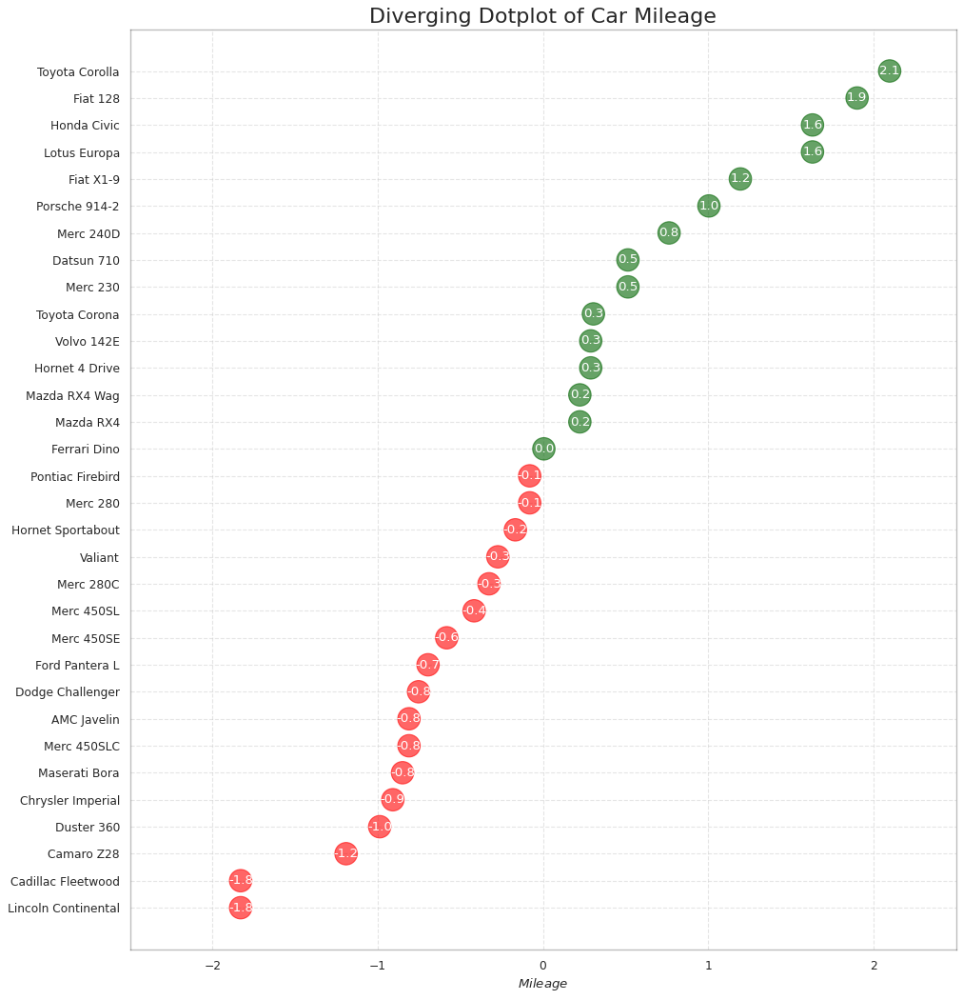

In [ ]:
# Prepare Data
df = pd.read_csv("https://github.com/selva86/datasets/raw/master/mtcars.csv")
x = df.loc[:, ['mpg']]
df['mpg_z'] = (x - x.mean())/x.std()
df['colors'] = ['red' if x < 0 else 'darkgreen' for x in df['mpg_z']]
df.sort_values('mpg_z', inplace=True)
df.reset_index(inplace=True)

# Draw plot
plt.figure(figsize=(14,16), dpi= 80)
plt.scatter(df.mpg_z, df.index, s=450, alpha=.6, color=df.colors)
for x, y, tex in zip(df.mpg_z, df.index, df.mpg_z):
    t = plt.text(x, y, round(tex, 1), horizontalalignment='center', 
                 verticalalignment='center', fontdict={'color':'white'})

# Decorations
# Lighten borders
plt.gca().spines["top"].set_alpha(.3)
plt.gca().spines["bottom"].set_alpha(.3)
plt.gca().spines["right"].set_alpha(.3)
plt.gca().spines["left"].set_alpha(.3)

plt.yticks(df.index, df.cars)
plt.title('Diverging Dotplot of Car Mileage', fontdict={'size':20})
plt.xlabel('$Mileage$')
plt.grid(linestyle='--', alpha=0.5)
plt.xlim(-2.5, 2.5)
plt.show()

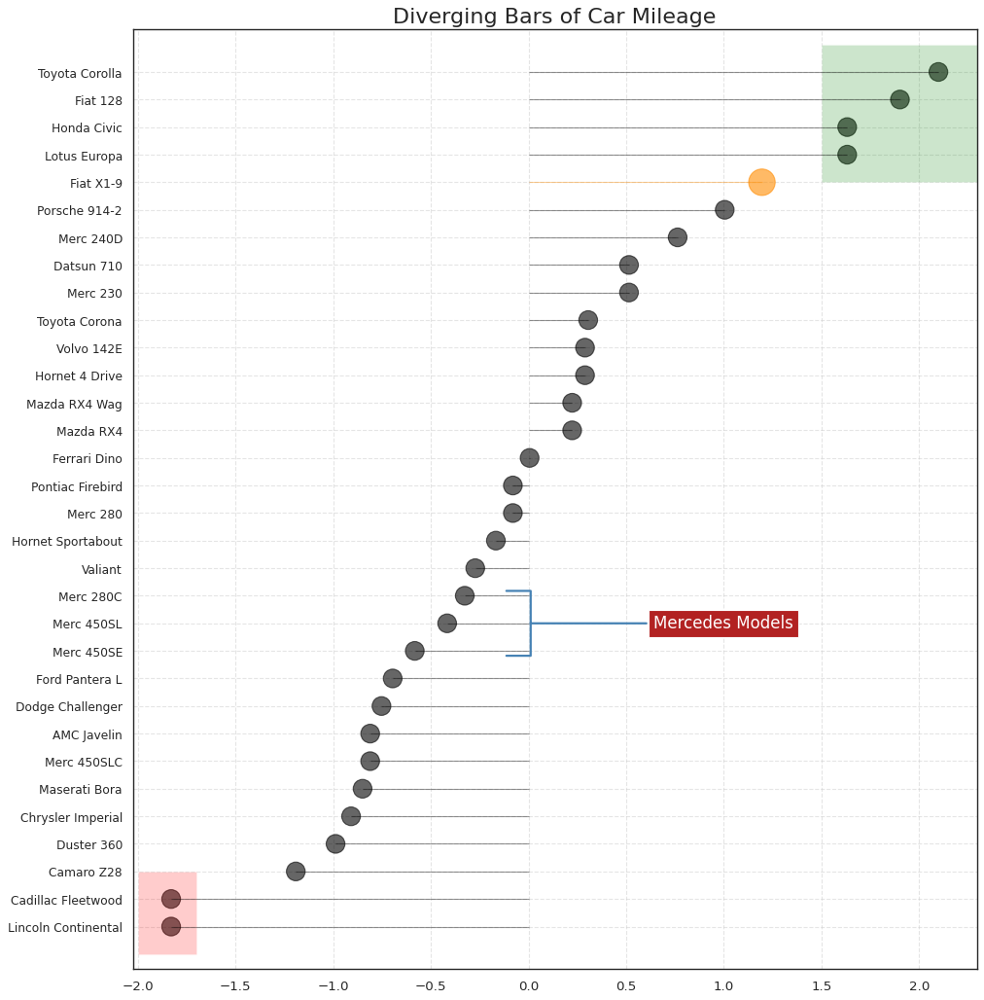

In [ ]:
# Prepare Data
df = pd.read_csv("https://github.com/selva86/datasets/raw/master/mtcars.csv")
x = df.loc[:, ['mpg']]
df['mpg_z'] = (x - x.mean())/x.std()
df['colors'] = 'black'

# color fiat differently
df.loc[df.cars == 'Fiat X1-9', 'colors'] = 'darkorange'
df.sort_values('mpg_z', inplace=True)
df.reset_index(inplace=True)


# Draw plot
import matplotlib.patches as patches

plt.figure(figsize=(14,16), dpi= 80)
plt.hlines(y=df.index, xmin=0, xmax=df.mpg_z, color=df.colors, alpha=0.4, linewidth=1)
plt.scatter(df.mpg_z, df.index, color=df.colors, s=[600 if x == 'Fiat X1-9' else 300 for x in df.cars], alpha=0.6)
plt.yticks(df.index, df.cars)
plt.xticks(fontsize=12)

# Annotate
plt.annotate('Mercedes Models', xy=(0.0, 11.0), xytext=(1.0, 11), xycoords='data', 
            fontsize=15, ha='center', va='center',
            bbox=dict(boxstyle='square', fc='firebrick'),
            arrowprops=dict(arrowstyle='-[, widthB=2.0, lengthB=1.5', lw=2.0, color='steelblue'), color='white')

# Add Patches
p1 = patches.Rectangle((-2.0, -1), width=.3, height=3, alpha=.2, facecolor='red')
p2 = patches.Rectangle((1.5, 27), width=.8, height=5, alpha=.2, facecolor='green')
plt.gca().add_patch(p1)
plt.gca().add_patch(p2)

# Decorate
plt.title('Diverging Bars of Car Mileage', fontdict={'size':20})
plt.grid(linestyle='--', alpha=0.5)
plt.show()


In [ ]:
import plotly.express as px
df = px.data.iris()
df["e_plus"] = df["sepal_width"]/100
df["e_minus"] = df["sepal_width"]/40
fig = px.scatter(df, x="sepal_width", y="sepal_length", color="species",
                 error_y="e_plus", error_y_minus="e_minus")
fig.show()

In [ ]:
import plotly.express as px
df = px.data.iris()
fig = px.scatter(df, x="sepal_width", y="sepal_length", color="species",
                 size='petal_length', hover_data=['petal_width'])
fig.show()

image.png

## Catplot

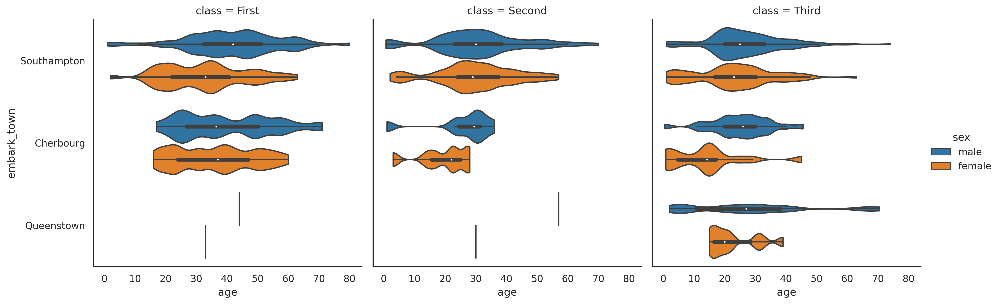

In [ ]:
# Load Dataset
titanic = sns.load_dataset("titanic")

# Plot
sns.catplot(x="age", y="embark_town",
            hue="sex", col="class",
            data=titanic[titanic.embark_town.notnull()],
            orient="h", height=5, aspect=1, palette="tab10",
            kind="violin", dodge=True, cut=0, bw=.2)

image.png

# <h1><left><font size=10><a name='link6'>7.0:Circular Plots</a></center>


## Sunburst Plots

### A sunburst chart is a type of data visualization that is used to display hierarchical data in a circular format. It is similar to a treemap or a tree diagram, but with a radial layout that makes it easier to see the overall structure of the data.

### In a sunburst chart, the outermost ring represents the top-level category or the root node of the hierarchy, while the inner rings represent the subcategories or child nodes. The size of each ring is proportional to the value of the data, and the color is used to differentiate between the subcategories or to represent a different variable.

### The sunburst chart is interactive and allows the user to drill down and explore the data by clicking on each segment, revealing the next level of subcategories. This makes it easy to see the overall structure of the data, and to identify patterns or trends in the data that may not be apparent in other types of visualizations.

### Sunburst charts are commonly used to visualize hierarchical data, such as organizational structures, file systems, or product categories. They can be an effective tool for communicating complex information to a broad audience, and for exploring the relationships between different variables in the data.

### When do we use Sunburst Charts

### Sunburst charts are particularly useful when we want to visualize hierarchical data in a compact and easy-to-understand format. Here are some examples of situations where sunburst charts may be useful:

### `Organizational structures`: Sunburst charts can be used to represent the hierarchy of departments or teams within an organization, making it easy to understand the overall structure and relationships between different departments or teams.

### `Product categories`: Sunburst charts can be used to represent the categories of products sold by a company or a retailer, making it easy to understand the relationships between different product categories and subcategories.

### `File systems`: Sunburst charts can be used to represent the file systems of a computer, making it easy to understand the overall structure of the files and folders, and to drill down to individual files and folders.

### `Financial data`: Sunburst charts can be used to represent the different levels of financial data, such as revenue, expenses, and profits, making it easy to understand the relationship between different categories of financial data.

### `Note`

### In general, sunburst charts can be useful in any situation where we need to represent hierarchical data in a compact and easy-to-understand format. They are particularly effective for interactive data exploration and analysis, where users can click on different segments of the chart to drill down into the data and explore the relationships between different variables.

### Advantages

### They are effective for visualizing hierarchical data in a compact and easy-to-understand format, making it easy to see the overall structure of the data and the relationships between different categories and subcategories.

### They are interactive, allowing users to drill down into the data and explore the relationships between different variables, making them an effective tool for data exploration and analysis.

### They can be visually appealing and can effectively communicate complex information to a broad audience.

### Disadvantages

### They can be difficult to interpret accurately if the hierarchy is too complex, making it challenging to identify specific relationships between categories or subcategories.

### They may not be suitable for displaying large amounts of data, as the visual clutter can make it challenging to interpret the data accurately.

### They can be misleading if the segments of the chart are not proportional to the value of the data, or if the colors are not used effectively to differentiate between different categories or subcategories.

### `Note`

### In summary, while sunburst charts can be an effective tool for visualizing hierarchical data, it's essential to consider their limitations and ensure that the data is suitable for this type of visualization before using it. It's also important to use effective design principles, such as appropriate color choices and clear labeling, to ensure that the chart is easy to interpret accurately.





### Practical Applications of :Sunburst Charts

##### `Distribution of Day of the Week, time Sex and Total Bills`

In [ ]:
import plotly.express as px
df = px.data.tips()
df.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


<IPython.core.display.Javascript object>

In [ ]:

df.groupby(['day','time','sex'])['total_bill'].count().sort_values(ascending = False).head()

day   time    sex   
Sat   Dinner  Male      59
Sun   Dinner  Male      58
Thur  Lunch   Female    31
              Male      30
Sat   Dinner  Female    28
Name: total_bill, dtype: int64

<IPython.core.display.Javascript object>

In [ ]:
# Sunburst of a rectangular DataFrame
import plotly.express as px
fig = px.sunburst(df, path=['day', 'time', 'sex'], values='total_bill')
fig.show()

<IPython.core.display.Javascript object>

image.png

#### `Distribution of Day, Smoker, Sex and Total Bills`

In [ ]:

df.groupby(['day','smoker','sex'])['total_bill'].count().sort_values(ascending = False).head()

day   smoker  sex   
Sun   No      Male      43
Sat   No      Male      32
      Yes     Male      27
Thur  No      Female    25
              Male      20
Name: total_bill, dtype: int64

<IPython.core.display.Javascript object>

In [ ]:
# Sunburst of a rectangular DataFrame
import plotly.express as px
fig = px.sunburst(df, path=['day', 'smoker', 'sex'], values='total_bill')
fig.show()

<IPython.core.display.Javascript object>

image.png

In [ ]:
# Sunburst of a rectangular DataFrame with discrete color argument in px.sunburst
import plotly.express as px
fig = px.sunburst(df, path=['sex', 'day', 'time'], values='total_bill', color='time')
fig.show()

image.png

In [ ]:
# Sunburst of a rectangular DataFrame with discrete color argument in px.sunburst
import plotly.express as px
fig = px.sunburst(df, path=['sex', 'day', 'time'], values='total_bill', color='sex')
fig.show()

image.png

In [ ]:
import plotly.express as px
fig = px.sunburst(df, path=['sex', 'day', 'time'], values='total_bill', color='time',
                  color_discrete_map={'(?)':'black', 'Lunch':'gold', 'Dinner':'darkblue'})
fig.show()

image.png

In [ ]:
import plotly.express as px
fig = px.sunburst(df, path=['sex', 'day', 'time'], values='total_bill', color='time',
                  color_discrete_map={'(?)':'red', 'Lunch':'gold', 'Dinner':'green'})
fig.show()

image.png

In [ ]:
import plotly.express as px
fig = px.sunburst(df, path=['sex', 'day', 'smoker'], values='total_bill')
fig.show()

#### `Distribution of Countries and their GDP, Life Expetancy, Population etc.`

In [ ]:
f = px.data.gapminder()
f.head(4)

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
0,Afghanistan,Asia,1952,28.801,8425333,779.445314,AFG,4
1,Afghanistan,Asia,1957,30.332,9240934,820.853030,AFG,4
2,Afghanistan,Asia,1962,31.997,10267083,853.100710,AFG,4
3,Afghanistan,Asia,1967,34.020,11537966,836.197138,AFG,4


In [ ]:
f.shape

(1704, 8)

In [ ]:
import plotly.express as px

df = px.data.gapminder().query("year == 2007")
fig = px.sunburst(df, path=['continent', 'country'], values='pop',
                  color='lifeExp', hover_data=['iso_alpha'])
fig.show()

In [ ]:
import plotly.express as px
import numpy as np
df = px.data.gapminder().query("year == 2007")
fig = px.treemap(df, path=[px.Constant('world'), 'continent', 'country'], values='pop',
                  color='lifeExp', hover_data=['iso_alpha'])
fig.show()


In [ ]:
import plotly.express as px
import numpy as np
df = px.data.gapminder().query("year == 2007")
fig = px.icicle(df, path=[px.Constant('world'), 'continent', 'country'], values='pop',
                  color='lifeExp', hover_data=['iso_alpha'])
fig.show()

image.png

In [ ]:
import plotly.graph_objects as go
import pandas as pd


In [ ]:
df1 = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/718417069ead87650b90472464c7565dc8c2cb1c/sunburst-coffee-flavors-complete.csv')
df2 = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/718417069ead87650b90472464c7565dc8c2cb1c/coffee-flavors.csv')

In [ ]:
fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=df1.ids,
    labels=df1.labels,
    parents=df1.parents,
    domain=dict(column=0)
))

fig.add_trace(go.Sunburst(
    ids=df2.ids,
    labels=df2.labels,
    parents=df2.parents,
    domain=dict(column=1),
    maxdepth=2
))

fig.update_layout(
    grid= dict(columns=2, rows=1),
    margin = dict(t=0, l=0, r=0, b=0)
)

fig.show()

image.png

## Pie Chart

### A pie chart is a circular data visualization that is used to display data as a proportion or percentage of the whole. It is divided into sectors, or "slices," which represent different categories or values. Each slice is proportional to the value it represents, and the total of all slices represents the whole data set.

### Pie charts are commonly used to represent data that is divided into a small number of categories, typically no more than six or seven. They are particularly useful for displaying data that is easy to understand at a glance, such as market share, budget allocation, or demographic data.

### Pie charts are simple and easy to read, making them an effective tool for communicating data to a broad audience. They can also be effective for comparing the relative proportions of different categories, as the slices are easily comparable in size.

### However, pie charts do have some limitations. They can be difficult to read accurately if the number of categories is too large or if the differences in value between categories are too small. In addition, they can be misleading if the slices are not proportional to the value of the data or if the colors used to differentiate between slices are not used effectively.

### `Note`

### In summary, pie charts are a useful tool for displaying data as a proportion or percentage of the whole, particularly when the number of categories is small and the differences in value between categories are large. However, it's important to consider the limitations of pie charts and to use them appropriately to ensure that they effectively communicate the data to the intended audience.

### When do we use Pie Charts

### Pie charts are most effective when they are used to display data that is divided into a small number of categories, typically no more than six or seven. They are commonly used in situations where it is essential to represent data as a proportion or percentage of the whole. Here are some examples of situations where pie charts may be useful:

- ### `Market share`: Pie charts can be used to represent the market share of different companies or products in a particular market, making it easy to understand the relative proportions of each company's share.

- ### `Budget allocation`: Pie charts can be used to represent the allocation of funds in a budget, making it easy to understand the relative proportions of the funds allocated to different categories, such as salaries, operations, and marketing.

- ### `Demographic data`: Pie charts can be used to represent the demographic composition of a population, making it easy to understand the relative proportions of different age groups, genders, or ethnicities.

- ### `Survey results`: Pie charts can be used to represent the results of a survey, making it easy to understand the percentage of respondents who answered a particular way.

### `Note`

### In general, pie charts are most effective when the data is straightforward and easy to understand, and when it is essential to represent the data as a proportion or percentage of the whole. It's important to use them appropriately and to consider the limitations of pie charts to ensure that they effectively communicate the data to the intended audience.

### Advantagee

- ### They are simple and easy to understand, making them an effective tool for communicating data to a broad audience.

- ### They are visually appealing and can be used to emphasize key data points.

- ### They are effective for displaying data as a proportion or percentage of the whole.

### Disadvantages


- ### They can be difficult to read accurately if the number of categories is too large or if the differences in value between categories are too small.

- ### They can be misleading if the slices are not proportional to the value of the data or if the colors used to differentiate between slices are not used effectively.

- ### They are not effective for displaying raw data or absolute values.

### `Note`

### In general, pie charts are most effective when the data is straightforward and easy to understand, and when it is essential to represent the data as a proportion or percentage of the whole. It's important to use them appropriately and to consider the limitations of pie charts to ensure that they effectively communicate the data to the intended audience. In situations where the data is complex or difficult to understand, other types of charts or graphs may be more appropriate.

### Aplications of Pie Charts

#### `Pie Chart and Tree Map Showing a Class of Vehicles`

In [ ]:
import pandas as pd
url="https://raw.githubusercontent.com/hayfordosmandata/DataBank/main/mpg_ggplot2.csv"
df=pd.read_csv(url, encoding="unicode_escape")

# First 4 rows of the dataset
df.head(4)

,manufacturer,model,displ,year,cyl,trans,drv,cty,hwy,fl,class
0,audi,a4,1.8,1999,4,auto(l5),f,18,29,p,compact
1,audi,a4,1.8,1999,4,manual(m5),f,21,29,p,compact
2,audi,a4,2.0,2008,4,manual(m6),f,20,31,p,compact
3,audi,a4,2.0,2008,4,auto(av),f,21,30,p,compact


<IPython.core.display.Javascript object>

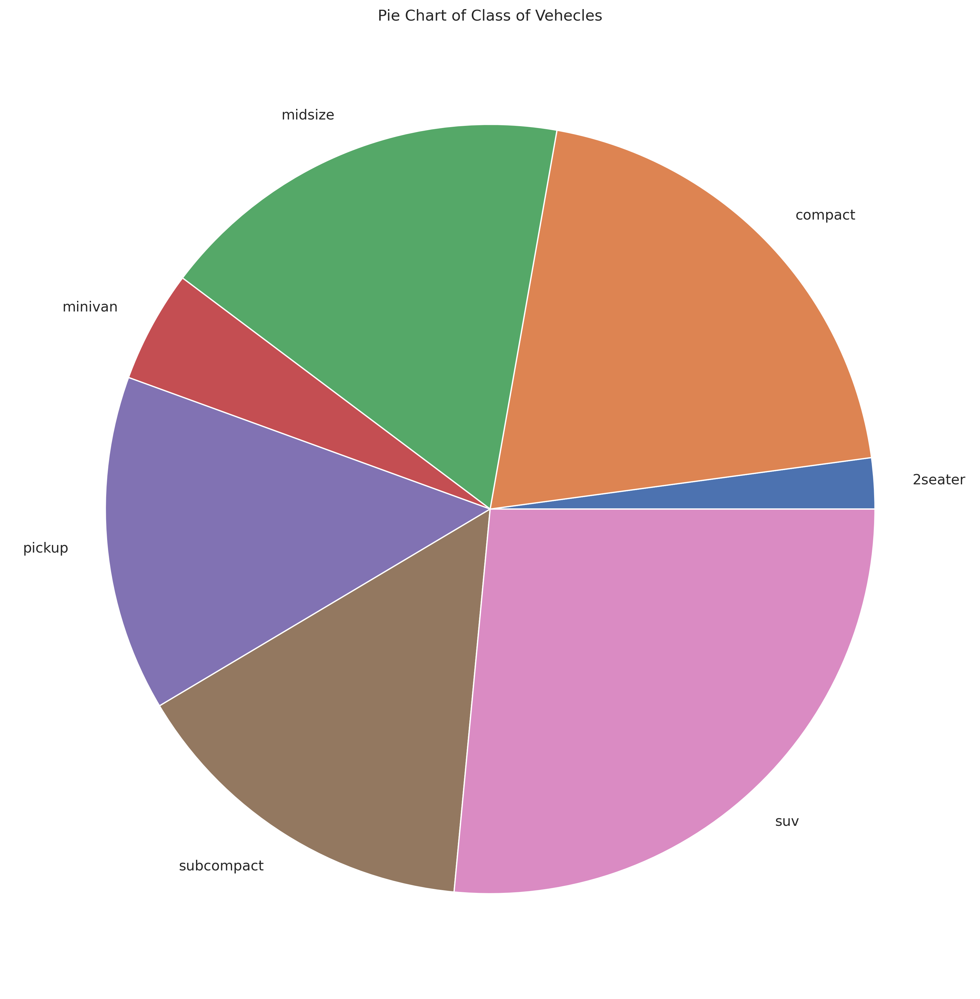

<IPython.core.display.Javascript object>

In [ ]:
# Pie Chart of Class of Vehicles
data = df.groupby('class').size()
# Make the plot with pandas
data.plot(kind='pie', subplots=True, figsize=(25, 14))
plt.title("Pie Chart of Class of Vehecles")
plt.ylabel("")
plt.show()

image.png

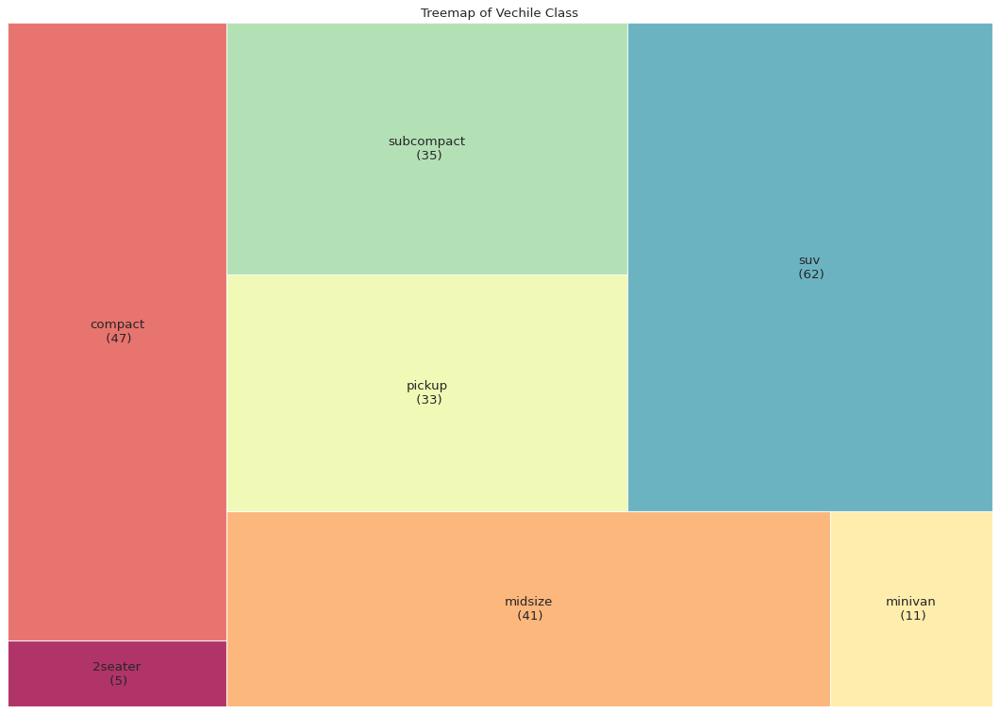

<IPython.core.display.Javascript object>

In [ ]:
# pip install squarify
import squarify 
data = df.groupby('class').size().reset_index(name='counts')
labels = data.apply(lambda x: str(x[0]) + "\n (" + str(x[1]) + ")", axis=1)
sizes = data['counts'].values.tolist()
colors = [plt.cm.Spectral(i/float(len(labels))) for i in range(len(labels))]

# Draw Plot
plt.figure(figsize=(15,12), dpi= 80)
squarify.plot(sizes=sizes, label=labels, color=colors, alpha=.8)

# Decorate
plt.title('Treemap of Vechile Class')
plt.axis('off')
plt.show()

image.png

In [ ]:
# Using Gapminder 
df= px.data.gapminder().head()
df

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
0,Afghanistan,Asia,1952,28.801,8425333,779.445314,AFG,4
1,Afghanistan,Asia,1957,30.332,9240934,820.853030,AFG,4
2,Afghanistan,Asia,1962,31.997,10267083,853.100710,AFG,4
3,Afghanistan,Asia,1967,34.020,11537966,836.197138,AFG,4
4,Afghanistan,Asia,1972,36.088,13079460,739.981106,AFG,4


<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px
df = px.data.gapminder().query("year == 2007").query("continent == 'Europe'")
df.loc[df['pop'] < 2.e6, 'country'] = 'Other countries' # Represent only large countries
fig = px.pie(df, values='pop', names='country', title='Population of European continent')
fig.show()

<IPython.core.display.Javascript object>

image.png

## Bar Charts

### A bar chart is a graphical representation of data in which bars of equal width are used to represent the values of a set of variables. The height of each bar is proportional to the value it represents. Bar charts are commonly used to compare the relative sizes of different categories or groups.

### Bar charts are often used in data visualization to help people quickly understand complex data sets. They are easy to read and can be used to illustrate trends over time, compare values between different categories or groups, and highlight outliers or unusual data points.

### Bar charts can be created using a variety of software tools, including spreadsheet programs like Microsoft Excel, as well as specialized data visualization software like Tableau and Power BI. There are also many online tools and libraries that allow you to create interactive and dynamic bar charts.


### Advantages

### Bar charts have several advantages and disadvantages that should be considered when deciding whether to use them to represent data. Here are some of the key advantages and disadvantages of using bar charts:

#### Advantages:

- ### `Easy to read`: Bar charts are a simple and straightforward way to present data. The bars make it easy to compare values and see trends over time or across different categories.

- ### `Visually appealing`: Bar charts can be visually appealing and can help to draw attention to important data or trends.

- ### `Flexible`: Bar charts can be used to represent many different types of data, including categorical, numerical, and ordinal data.

- ### `Widely recognized`: Bar charts are a common and widely recognized type of chart, making them easy for viewers to understand and interpret.

### Disadvantages

### Disadvantages:

- ### `Limited detail`: Bar charts may not be suitable for data that requires a more detailed analysis or for data that contains many variables or categories.

- ### `Can be misleading`: If the bars are not properly scaled or if the axis is manipulated, bar charts can be misleading and misrepresent the data.

- ### `Limited use for continuous data`: Bar charts are not always the best choice for continuous data or data that is highly variable.

- ### `Limited space for labels`: If the labels for the categories or bars are long, it may be difficult to fit them onto the chart, which can make the chart harder to read.

### Overall, bar charts are a useful tool for representing data, but they may not always be the best choice depending on the type of data being presented and the goals of the analysis. It is important to consider the advantages and disadvantages of using bar charts, as well as other types of charts, before deciding which chart to use.

In [ ]:
import plotly.express as px
df = px.data.medals_long()

fig = px.bar(df, x="medal", y="count", color="nation",
             pattern_shape="nation", pattern_shape_sequence=[".", "x", "+"])
fig.show()

In [ ]:
import plotly.express as px
data_canada = px.data.gapminder().query("country == 'Canada'")
fig = px.bar(data_canada, x='year', y='pop')
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
long_df = px.data.medals_long()
long_df.head()

,nation,medal,count
0,South Korea,gold,24
1,China,gold,10
2,Canada,gold,9
3,South Korea,silver,13
4,China,silver,15


<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px

long_df = px.data.medals_long()

fig = px.bar(long_df, x="nation", y="count", color="medal", title="Long-Form Input")
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px

wide_df = px.data.medals_wide()

fig = px.bar(wide_df, x="nation", y=["gold", "silver", "bronze"], title="Wide-Form Input")
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px

df = px.data.gapminder().query("country == 'Canada'")
fig = px.bar(df, x='year', y='pop',
             hover_data=['lifeExp', 'gdpPercap'], color='lifeExp',
             labels={'pop':'population of Canada'}, height=400)
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px

df = px.data.gapminder().query("continent == 'Oceania'")
fig = px.bar(df, x='year', y='pop',
             hover_data=['lifeExp', 'gdpPercap'], color='country',
             labels={'pop':'population of Canada'}, height=400)
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.bar(df, x="sex", y="total_bill", color='time')
fig.show()


<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.bar(df, x="sex", y="total_bill",
             color='smoker', barmode='group',
             height=400)
fig.show()


<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.histogram(df, x="sex", y="total_bill",
             color='smoker', barmode='group',
             height=400)
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.histogram(df, x="sex", y="total_bill",
             color='smoker', barmode='group',
             histfunc='avg',
             height=400)
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px
df = px.data.medals_long()

fig = px.bar(df, x="medal", y="count", color="nation", text_auto=True)
fig.show()


<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px
df = px.data.medals_long()

fig = px.bar(df, x="medal", y="count", color="nation", text="nation")
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px

df = px.data.gapminder().query("continent == 'Europe' and year == 2007 and pop > 2.e6")
fig = px.bar(df, y='pop', x='country', text_auto='.2s',
            title="Default: various text sizes, positions and angles")
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px

df = px.data.gapminder().query("continent == 'Europe' and year == 2007 and pop > 2.e6")
fig = px.bar(df, y='pop', x='country', text_auto='.2s',
            title="Controlled text sizes, positions and angles")
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px
df = px.data.medals_long()

fig = px.bar(df, x="medal", y="count", color="nation",
             pattern_shape="nation", pattern_shape_sequence=[".", "x", "+"])
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.express as px
df = px.data.tips()
fig = px.bar(df, x="sex", y="total_bill", color="smoker", barmode="group",
             facet_row="time", facet_col="day",
             category_orders={"day": ["Thur", "Fri", "Sat", "Sun"],
                              "time": ["Lunch", "Dinner"]})
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.graph_objects as go
animals=['giraffes', 'orangutans', 'monkeys']

fig = go.Figure([go.Bar(x=animals, y=[20, 14, 23])])
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
import plotly.graph_objects as go

years = ['2016','2017','2018']

fig = go.Figure()
fig.add_trace(go.Bar(x=years, y=[500, 600, 700],
                base=[-500,-600,-700],
                marker_color='crimson',
                name='expenses'))
fig.add_trace(go.Bar(x=years, y=[300, 400, 700],
                base=0,
                marker_color='lightslategrey',
                name='revenue'
                ))

fig.show()

<IPython.core.display.Javascript object>

## Radar Charts in Matplotlib

###  A  radar chart, also known as a spider chart or a star chart, is a graphical representation of data that displays multivariate data in the form of a two-dimensional chart. It is called a radar chart because the chart's appearance resembles a radar screen, with each variable being represented by a spoke or axis that originates from the center point of the chart.

### In a radar chart, each axis represents a different variable, and the data points for each variable are plotted along their respective axes. The resulting shape formed by the data points can provide insight into the relationship between the variables, and can be useful for visualizing patterns, trends, and outliers in the data.

### Radar charts are often used in fields such as business, engineering, and sports to display and compare data from multiple sources. They can also be used in market research to display customer preferences, in performance evaluations to display employee performance, and in environmental studies to display the impact of different factors on the environment. 

### When do we use Radar Charts

### Radar charts can be used to visualize and compare multiple variables, making them useful in situations where it is necessary to display data in a comprehensive and easily understandable way. Here are a few specific situations where radar charts may be useful:

- ### `Performance evaluation`: Radar charts can be used to evaluate and compare the performance of multiple individuals or teams. By plotting different performance metrics on each axis, you can quickly see which individuals or teams are performing well in certain areas and which ones need improvement.

- ### `Marketing`: Radar charts can be used to display the preferences and opinions of customers. By plotting different features or attributes of a product on each axis, you can quickly see which features are most important to customers and how they compare to those of competing products.

- ### `Environmental studies`: Radar charts can be used to display the impact of multiple factors on the environment. By plotting different environmental factors on each axis, you can see which factors have the greatest impact on the environment and how they interact with each other.

- ### Sports analysis`: Radar charts can be used to compare the performance of athletes in different areas, such as speed, strength, and agility. By plotting each athlete's performance on each axis, you can quickly see which athletes excel in certain areas and which ones need improvement.

### Overall, radar charts can be useful in any situation where it is necessary to display and compare multiple variables in a clear and concise way.

### Advantages

### Advantages of using radar charts include:

- ### `Visualizing multiple variables`: Radar charts are useful for visualizing and comparing multiple variables, which makes them a valuable tool in fields such as business, sports, and engineering.

- ### `Highlighting strengths and weaknesses`: Radar charts make it easy to identify the strengths and weaknesses of a particular entity, such as an individual, team, or product. By highlighting these strengths and weaknesses, it is easier to take action to improve performance.

- ### `Providing a quick overview`: Radar charts provide a quick and easy-to-understand overview of the data. They allow you to identify patterns, trends, and outliers at a glance.

- ### `Facilitating comparisons`: Radar charts are effective for comparing data across different groups or time periods. By plotting the data on the same chart, it is easy to compare the performance of different entities over time.

### Disadvantages

### Disadvantages of using radar charts include:

- ### `Difficulty with large data sets`: Radar charts can become cluttered and difficult to read with large data sets, which can make it hard to identify patterns or outliers.

- ### `Subjectivity`: The interpretation of radar charts can be subjective, and different people may interpret the same chart differently.

- ### `Limited use with non-scalar data`: Radar charts are designed for use with scalar data, and may not be effective for visualizing non-scalar data.

- ### `Limited use for statistical analysis`: Radar charts do not allow for advanced statistical analysis, such as regression analysis, which may be necessary in some applications.

### Overall, radar charts are a valuable tool for visualizing and comparing multiple variables, but they have some limitations and may not be appropriate in all situations.

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
# For our sample data.
from vega_datasets import data


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
# For our sample data.
from vega_datasets import data

In [ ]:
df=data.cars()

In [ ]:
df.head()

,Name,Miles_per_Gallon,Cylinders,Displacement,Horsepower,Weight_in_lbs,Acceleration,Year,Origin
0,chevrolet chevelle malibu,18.0,8,307.0,130.0,3504,12.0,1970-01-01,USA
1,buick skylark 320,15.0,8,350.0,165.0,3693,11.5,1970-01-01,USA
2,plymouth satellite,18.0,8,318.0,150.0,3436,11.0,1970-01-01,USA
3,amc rebel sst,16.0,8,304.0,150.0,3433,12.0,1970-01-01,USA
4,ford torino,17.0,8,302.0,140.0,3449,10.5,1970-01-01,USA


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
# For our sample data.
from vega_datasets import data

In [ ]:
df.head()

,Name,Miles_per_Gallon,Cylinders,Displacement,Horsepower,Weight_in_lbs,Acceleration,Year,Origin
0,chevrolet chevelle malibu,18.0,8,307.0,130.0,3504,12.0,1970-01-01,USA
1,buick skylark 320,15.0,8,350.0,165.0,3693,11.5,1970-01-01,USA
2,plymouth satellite,18.0,8,318.0,150.0,3436,11.0,1970-01-01,USA
3,amc rebel sst,16.0,8,304.0,150.0,3433,12.0,1970-01-01,USA
4,ford torino,17.0,8,302.0,140.0,3449,10.5,1970-01-01,USA


In [ ]:
# The attributes we want to use in our radar plot.
factors = ['Acceleration', 'Displacement', 'Horsepower',
           'Miles_per_Gallon', 'Weight_in_lbs']

# New scale should be from 0 to 100.
new_max = 100
new_min = 0
new_range = new_max - new_min

# Do a linear transformation on each variable to change value
# to [0, 100].
for factor in factors:
  max_val = df[factor].max()
  min_val = df[factor].min()
  val_range = max_val - min_val
  df[factor + '_Adj'] = df[factor].apply(
      lambda x: (((x - min_val) * new_range) / val_range) + new_min)


# Add the year to the name of the car to differentiate between
# the same model.
df['Car Model'] = df.apply(lambda row: '{} {}'.format(row.Name, row.Year.year), axis=1)

# Trim down to cols we want and rename to be nicer.
dft = df.loc[:, ['Car Model', 'Acceleration_Adj', 'Displacement_Adj',
                 'Horsepower_Adj', 'Miles_per_Gallon_Adj',
                 'Weight_in_lbs_Adj']]

dft.rename(columns={
    'Acceleration_Adj': 'Acceleration',
    'Displacement_Adj': 'Displacement',
    'Horsepower_Adj': 'Horsepower',
    'Miles_per_Gallon_Adj': 'MPG',
    'Weight_in_lbs_Adj': 'Weight'
}, inplace=True)

dft.set_index('Car Model', inplace=True)

dft.head()

,Acceleration,Displacement,Horsepower,MPG,Weight
Car Model,,,,,
chevrolet chevelle malibu 1970,23.809524,61.757106,45.652174,23.936170,53.614970
buick skylark 320 1970,20.833333,72.868217,64.673913,15.957447,58.973632
plymouth satellite 1970,17.857143,64.599483,56.521739,23.936170,51.686986
amc rebel sst 1970,23.809524,60.981912,56.521739,18.617021,51.601928
ford torino 1970,14.880952,60.465116,51.086957,21.276596,52.055571


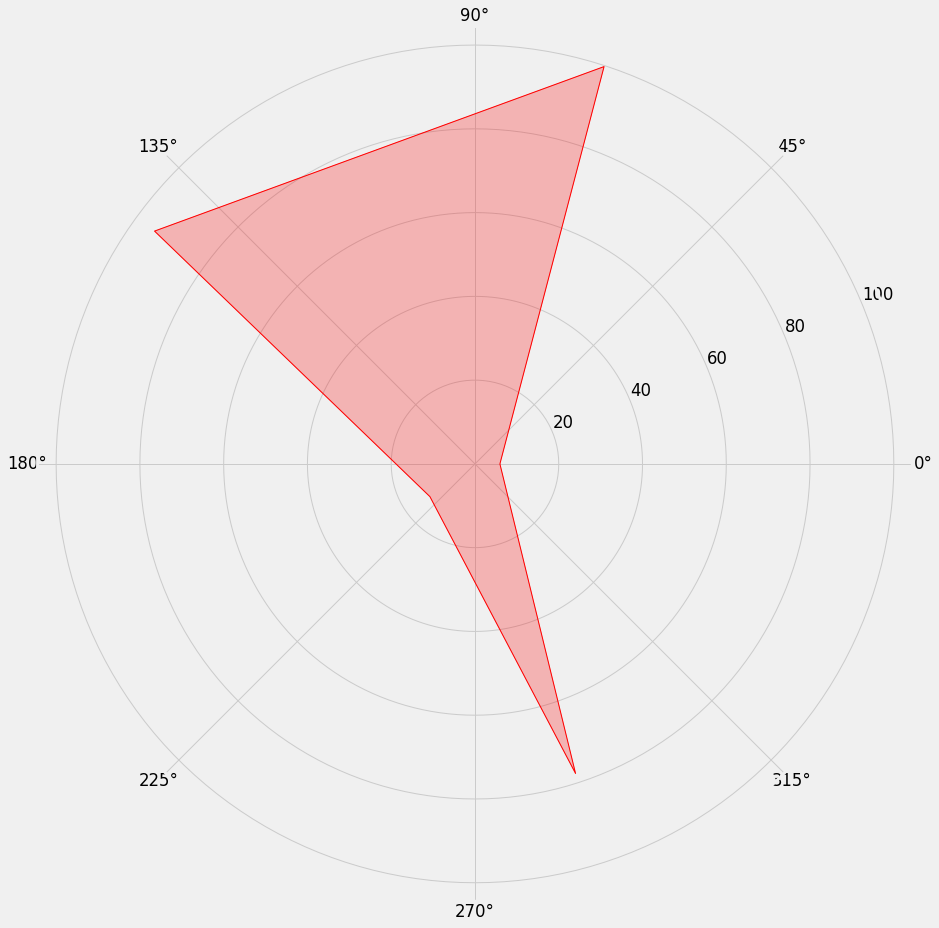

In [ ]:
# Each attribute we'll plot in the radar chart.
labels = ['Acceleration', 'Displacement', 'Horsepower', 'MPG', 'Weight']

# Let's look at the 1970 Chevy Impala and plot it.
values = dft.loc['chevrolet impala 1970'].tolist()

# Number of variables we're plotting.
num_vars = len(labels)

# Split the circle into even parts and save the angles
# so we know where to put each axis.
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

# The plot is a circle, so we need to "complete the loop"
# and append the start value to the end.
values += values[:1]
angles += angles[:1]

# ax = plt.subplot(polar=True)
fig, ax = plt.subplots(figsize=(30, 15), subplot_kw=dict(polar=True))

# Draw the outline of our data.
ax.plot(angles, values, color='red', linewidth=1)
# Fill it in.
ax.fill(angles, values, color='red', alpha=0.25);

image.png

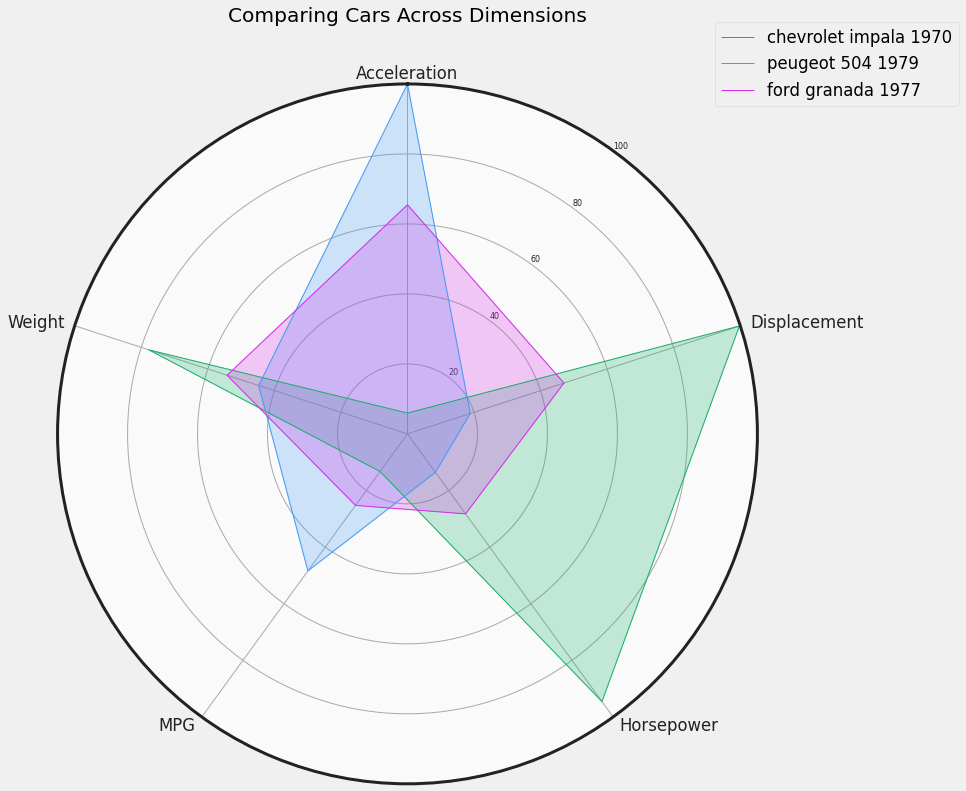

In [ ]:
# Each attribute we'll plot in the radar chart.
labels = ['Acceleration', 'Displacement', 'Horsepower', 'MPG', 'Weight']

# Number of variables we're plotting.
num_vars = len(labels)

# Split the circle into even parts and save the angles
# so we know where to put each axis.
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

# The plot is a circle, so we need to "complete the loop"
# and append the start value to the end.
angles += angles[:1]

# ax = plt.subplot(polar=True)
fig, ax = plt.subplots(figsize=(25, 12), subplot_kw=dict(polar=True))

# Helper function to plot each car on the radar chart.
def add_to_radar(car_model, color):
  values = dft.loc[car_model].tolist()
  values += values[:1]
  ax.plot(angles, values, color=color, linewidth=1, label=car_model)
  ax.fill(angles, values, color=color, alpha=0.25)

# Add each car to the chart.
add_to_radar('chevrolet impala 1970', '#1aaf6c')
add_to_radar('peugeot 504 1979', '#429bf4')
add_to_radar('ford granada 1977', '#d42cea')

# Fix axis to go in the right order and start at 12 o'clock.
ax.set_theta_offset(np.pi / 2)
ax.set_theta_direction(-1)

# Draw axis lines for each angle and label.
ax.set_thetagrids(np.degrees(angles), labels)

# Go through labels and adjust alignment based on where
# it is in the circle.
for label, angle in zip(ax.get_xticklabels(), angles):
  if angle in (0, np.pi):
    label.set_horizontalalignment('center')
  elif 0 < angle < np.pi:
    label.set_horizontalalignment('left')
  else:
    label.set_horizontalalignment('right')

# Ensure radar goes from 0 to 100.
ax.set_ylim(0, 100)
# You can also set gridlines manually like this:
# ax.set_rgrids([20, 40, 60, 80, 100])

# Set position of y-labels (0-100) to be in the middle
# of the first two axes.
ax.set_rlabel_position(180 / num_vars)

# Add some custom styling.
# Change the color of the tick labels.
ax.tick_params(colors='#222222')
# Make the y-axis (0-100) labels smaller.
ax.tick_params(axis='y', labelsize=8)
# Change the color of the circular gridlines.
ax.grid(color='#AAAAAA')
# Change the color of the outermost gridline (the spine).
ax.spines['polar'].set_color('#222222')
# Change the background color inside the circle itself.
ax.set_facecolor('#FAFAFA')

# Add title.
ax.set_title('Comparing Cars Across Dimensions', y=1.08)

# Add a legend as well.
ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))

## Polar Charts

### Polar charts, also known as polar area charts or rose charts, are a type of chart used to display multivariate data. They are similar to radar charts in that they use a circular axis system, but polar charts typically use a single axis that is divided into multiple sectors, with each sector representing a different variable.

### In a polar chart, the values for each variable are plotted as a series of data points around the circular axis. The data points are connected by lines, and the area enclosed by the lines is filled in to create a polar area chart. The resulting shape formed by the data points can provide insight into the relationship between the variables, and can be useful for visualizing patterns, trends, and outliers in the data.

### Polar charts are often used to display data with cyclical patterns, such as weather data or economic data that varies by season. They can also be used in fields such as engineering and biology to display data with a circular or radial structure, such as the distribution of plant species or the structural properties of materials.

### When do we use Polar Charts

### Polar charts are useful for visualizing multivariate data that have a circular or cyclical structure. Here are a few specific situations where polar charts may be useful:

- ### `Weather data`: Polar charts can be used to display weather data, such as temperature, wind speed, and precipitation, that varies by season. The circular axis of the chart represents the year, and each sector represents a month or season. By plotting the data on a polar chart, it is easy to identify seasonal patterns and trends.

- ### Economic data`: Polar charts can be used to display economic data that varies by season, such as sales data for a particular product or service. By plotting the data on a polar chart, it is easy to identify seasonal trends and patterns, which can be used to inform marketing or production strategies.

- ### `Material properties`: Polar charts can be used in fields such as engineering and biology to display data with a circular or radial structure, such as the distribution of plant species or the structural properties of materials. By plotting the data on a polar chart, it is easy to identify patterns and trends in the data, which can be used to inform research and development.

- ### `Survey data`: Polar charts can be used to display survey data that is measured on a scale with circular or cyclical properties, such as a Likert scale. By plotting the data on a polar chart, it is easy to identify patterns in the responses and to compare the responses of different groups.

### Overall, polar charts are a useful tool for visualizing multivariate data with a circular or cyclical structure, and can be used in a wide range of applications.

### Advantages

### Advantages of using polar charts include:

- ### `Highlighting cyclical or seasonal patterns`: Polar charts are particularly useful for displaying data that has a cyclical or seasonal structure, such as weather data, economic data, or survey data. By plotting the data on a circular axis, it is easy to identify patterns and trends in the data.

- ### `Displaying multiple variables`: Polar charts can display multiple variables on the same chart, which makes them useful for comparing and contrasting different sets of data.

- ### `Providing a visual summary`: Polar charts can provide a visual summary of complex data, making it easy to communicate the key insights to others. They are particularly useful in situations where the data is complex or difficult to interpret.

- ### `Supporting clear and concise communication`: Polar charts can help to convey information in a clear and concise manner, which is particularly useful in situations where time is limited or the audience has limited knowledge of the subject matter.

### Disadvantages

### Disadvantages of using polar charts include:

- ### `Difficulty with large data sets`: Polar charts can become cluttered and difficult to read with large data sets, which can make it hard to identify patterns or outliers.

- ### `Limited use for non-circular data`: Polar charts are designed for use with circular or cyclical data, and may not be effective for visualizing non-circular data.

- ### `Limited use for statistical analysis`: Polar charts do not allow for advanced statistical analysis, such as regression analysis, which may be necessary in some applications.

- ### `Subjectivity`: The interpretation of polar charts can be subjective, and different people may interpret the same chart differently.

### Overall, polar charts are a valuable tool for visualizing data that has a circular or cyclical structure, but they have some limitations and may not be appropriate in all situations. It is important to carefully consider the data and the audience before deciding to

In [ ]:
df = px.data.wind().head()
df

,direction,strength,frequency
0,N,0-1,0.5
1,NNE,0-1,0.6
2,NE,0-1,0.5
3,ENE,0-1,0.4
4,E,0-1,0.4


In [ ]:
import plotly.express as px
df = px.data.wind()
fig = px.scatter_polar(df, r="frequency", theta="direction", color="strength", symbol="strength",
            color_discrete_sequence=px.colors.sequential.Plasma_r)
fig.show()

In [ ]:
import plotly.express as px
df = px.data.wind()
fig = px.line_polar(df, r="frequency", theta="direction", color="strength", line_close=True,
            color_discrete_sequence=px.colors.sequential.Plasma_r)
fig.show()

In [ ]:
import plotly.express as px
df = px.data.wind()
fig = px.bar_polar(df, r="frequency", theta="direction", color="strength", template="plotly_dark",
            color_discrete_sequence= px.colors.sequential.Plasma_r)
fig.show()

image.png

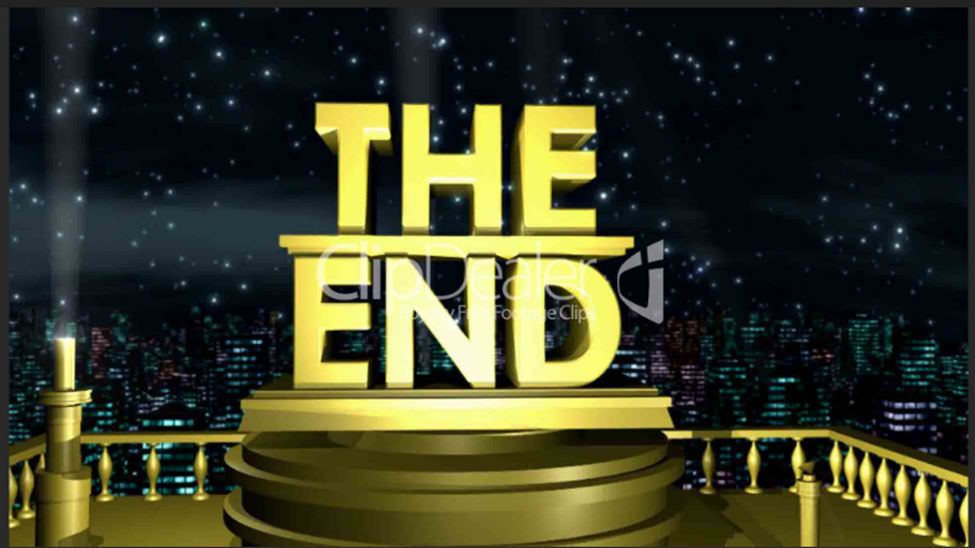